- 04/01 16:50 [안진용] 이니셜 커밋을 했습니다.
- 04/01 17:32 [이하은] 중복 이미지 탐지 결과를 커밋했습니다.
- 04/02 10:32 [천주호] 담당 부분 EDA 커밋
- 04/03 10:02 [김해원] EDA 완료. 전처리 파이프라인 설계 및 전처리 진행 코드 진행 예정
- 04/03 11:42 [김해원] EDA 및 파이프라인 설계 완료.
- 04/03 16:01 [김해원] 베이스라인 모델 정리 시작
- 04/04 16:30 [안진용] 3.1, 3.1.1 부분 기입 완료. 필요한 묘듈 임포트 추가 3가지
- 04/04 16:40 [김해원] 텍스처 필터링 eda & 전처리 blue에서 moon 골라내기 완료.
- 04/04 20:12 [안진용] 4.1.2 Mobilnet V2 성능검증 업데이트
- 04/04 23:35 [이하은] 2.3 중복 객체 이미지 제거, 배경 제거 성능 비교 업데이트
- 04/05 12:10 [안진용] 추가한 부분. 3.1.2 한 이미지 내에 여러 개체가 있는 경우를 제거한 성능검증,3.0.4 모델 구성 및 학습 구조 변화 정리 

# 0. 목차

1. **EDA 및 데이터 전처리 전략 설계**   
   1.1 샘플 이미지 확인   
   1.2 이미지 유사도 확인   ** 해원: 주호님 텍스처 필터링 업로드 중
   1.3 클래스 별 이미지 수 확인   
   1.4 중복 이미지 탐지   
   1.5 이미지 품질 확인   
   1.6 EDA 결론 및 전처리 전략 설계
   
2. **데이터 전처리**   
   2.1 배경 제거   
   2.2 blue jellyfish 데이터셋에서 moon jellyfish 골라내기   
   2.3 한 이미지 내 중복 개체가 있는 경우 제거 ** 하은   

4. **Baseline 모델 설계**   
    3.1 전처리 데이터 성능 검증 ** 진용   
        <tr> 3.1.1 배경제거 데이터 성능 검증 -> 배경 제거 효과가 없다  ** 진용   
    3.2 결론 및 모델 성능 개선 전략 설계

6. **모델 성능 개선**
    6.1 여러 모델 테스트

        a. CNN
#### 2. mobilenet v2
#### 3. mobilenet v3
#### 4. ConvNext
#### 5. Resnet50

8. **결론 및 인사이트 도출**

## 초기 세팅

In [1]:
#필요한 패키지 다운

!pip install wandb==0.16.0
!pip install opencv-python
!pip install ImageHash Pillow
!pip install rembg
!pip install onnxruntime
!pip install albumentations
!pip install scikit-image opencv-python tqdm seaborn
!pip install --upgrade numpy==1.20.0

     |████████████████████████████████| 2.1 MB 6.5 MB/s            
     |████████████████████████████████| 207 kB 85.1 MB/s            
     |████████████████████████████████| 339 kB 66.2 MB/s            
     |████████████████████████████████| 62 kB 1.8 MB/s             
     |████████████████████████████████| 144 kB 77.4 MB/s            
  Attempting uninstall: urllib3
    Found existing installation: urllib3 1.26.7
    Uninstalling urllib3-1.26.7:
      Successfully uninstalled urllib3-1.26.7
     |████████████████████████████████| 296 kB 6.5 MB/s            
     |████████████████████████████████| 40 kB 1.2 MB/s             
     |████████████████████████████████| 54 kB 2.5 MB/s             
     |████████████████████████████████| 13.2 MB 6.1 MB/s            
     |████████████████████████████████| 46 kB 5.0 MB/s             
     |████████████████████████████████| 19.5 MB 98.1 MB/s            
     |████████████████████████████████| 6.2 MB 64.2 MB/s            
     |████████████

In [2]:
#필요한 모듈 임포트
from tensorflow.keras import layers, models
from sklearn.metrics import confusion_matrix
import seaborn as sns
import pandas as pd
import tensorflow as tf
from tensorflow import keras
from sklearn.model_selection import train_test_split
import wandb
from wandb.keras import WandbCallback
from sklearn.preprocessing import LabelEncoder
from PIL import Image, ImageEnhance, ImageOps
import glob
import os
import matplotlib.pyplot as plt
import random
import cv2
import numpy as np
from pathlib import Path
import hashlib
import imagehash
from tensorflow.keras.preprocessing import image
from tensorflow.keras.preprocessing.image import ImageDataGenerator, load_img, img_to_array, save_img
from tqdm import tqdm
from rembg import remove
import io
from sklearn.metrics.pairwise import cosine_similarity, euclidean_distances, cosine_similarity
from sklearn.cluster import KMeans
from skimage.feature import hog
from tensorflow.keras import layers, models
from tensorflow.keras.applications import MobileNetV3Large, MobileNetV2
from tensorflow.keras.callbacks import ReduceLROnPlateau 
from tensorflow.keras.optimizers import Adam, RMSprop
import seaborn as sns
from sklearn.metrics import confusion_matrix, classification_report
import shutil
from tensorflow.keras.preprocessing import image_dataset_from_directory
from tensorflow.keras.preprocessing.image import load_img, img_to_array, save_img
from tensorflow.keras.applications import MobileNetV2
import albumentations as A
from skimage.feature import local_binary_pattern
from skimage.io import imread
from skimage.color import rgb2gray
from skimage.transform import resize
from scipy.spatial.distance import euclidean
from collections import defaultdict
from tensorflow.keras.callbacks import ModelCheckpoint

In [65]:
#통합 작업을 위한 경로 취합

#top_path
if os.path.exists("/aiffel/aiffel/jellyfish"):
    top_path = "/aiffel/aiffel/jellyfish"
elif os.path.exists("C:/Users/kimho/Dlthon_c1"):
    top_path = "C:/Users/kimho/Dlthon_c1"
elif os.path.exists("/root/aiffel/jellyfish"):
    top_path = "/root/aiffel/jellyfish"

#base_path(Train_Test_valid 폴더)
if os.path.exists("/aiffel/aiffel/jellyfish/Train_Test_Valid"):
    base_path = "/aiffel/aiffel/jellyfish/Train_Test_Valid"
elif os.path.exists("C:/Users/kimho/Dlthon_c1/Train_Test_Valid"):
    base_path = "C:/Users/kimho/Dlthon_c1/Train_Test_Valid"
elif os.path.exists("/root/aiffel/jellyfish/Train_Test_Valid"):
    base_path = "/root/aiffel/jellyfish/Train_Test_Valid"

train_path = os.path.join(base_path, "Train")
valid_path = os.path.join(base_path, "valid")
test_path = os.path.join(base_path, "test")

----
# 1. EDA 및 데이터 전처리 전략 설계

## 1.0 시도한 EDA 목록

1. **샘플 이미지** 확인
      - 해파리 외의 미칠 다른 요소들이 있는가? (배경 등...)
      - 특정 무늬나 형태로 구분할 수 있는 해파리가 있는가?
      - 색깔로 구분할 수 있는 해파리가 있는가?
      - 하나의 사진에 해파리가 여러마리 들어있는 경우가 있는가?

</n>

2. 이미지 **유사도** 확인
      - 다른 종이지만 비슷하게 생긴 해파리가 있는가?

</n>

3. 클래스 별 **이미지 수** 확인   
      - 클래스 간 imbalance 가능성 확인

</n>

4. **중복** 이미지 탐지

</n>

5. 이미지 **품질** 확인
      - 흐리거나 노이즈가 있는 이미지가 있는가?

## 1.1 샘플 이미지 확인



### 1.1.1 내용 요약

**[확인 사항]**
  - 해파리 외의 미칠 다른 요소들이 있는가? (배경 등...)
  - 특정 무늬나 형태로 구분할 수 있는 해파리가 있는가?
  - 색깔로 구분할 수 있는 해파리가 있는가?
  - 하나의 사진에 해파리가 여러마리 들어있는 경우가 있는가?


**[과정]**
1. 각 클래스 별 test, Train 이미지 5장/20장씩 출력해보고, 해파리 외의 영향을 미칠 다른 요소 있는지 파악 시도. (배경 등)   
2. Moon_jellyfish의 배경색이 파란색일 때 blue_jellyfish와 비슷해 보임.
3. Moon_jellyfish와 blue_jellyfish 각 샘플 이미지 50장을 출력하여 유사 정도 파악 시도.
4. 발견 사항   
  1) 샘플 중 이미 증강 처리 된 데이터가 있음을 확인   
  2) blue_jellyfish 샘플 속 moon_jellyfish로 보이는 샘플 다수 발견

### 1.1.2 각 클래스 별 test, Train 이미지 5장/ 20장 출력

#### 1) barrel_jellyfish

In [ ]:
# 해파리 클래스 중 하나 선택
sample_class = "barrel_jellyfish"
class_path = os.path.join(train_path, sample_class)

# 파일 목록에서 무작위로 20장 선택
sample_images = random.sample(os.listdir(class_path), 20)

# 시각화
plt.figure(figsize=(20, 10))  # 사이즈도 키우기
for i, img_name in enumerate(sample_images):
    img_path = os.path.join(class_path, img_name)
    img = Image.open(img_path)
    plt.subplot(4, 5, i+1)  # 4행 5열
    plt.imshow(img)
    plt.title(sample_class.replace("_", " ").title())
    plt.axis("off")
plt.tight_layout()
plt.show()

#### 2) blue_jellyfish

In [ ]:
# 해파리 클래스 중 하나 선택
sample_class = "blue_jellyfish"
class_path = os.path.join(train_path, sample_class)

# 파일 목록에서 무작위로 5장 선택
sample_images = random.sample(os.listdir(class_path), 20)

# 시각화
plt.figure(figsize=(20, 10))  # 사이즈도 키우기
for i, img_name in enumerate(sample_images):
    img_path = os.path.join(class_path, img_name)
    img = Image.open(img_path)
    plt.subplot(4, 5, i+1)  # 4행 5열
    plt.imshow(img)
    plt.title(sample_class.replace("_", " ").title())
    plt.axis("off")
plt.tight_layout()
plt.show()

#### 3) compass_jellyfish

In [ ]:
# 해파리 클래스 중 하나 선택
sample_class = "compass_jellyfish"
class_path = os.path.join(train_path, sample_class)

# 파일 목록에서 무작위로 5장 선택
sample_images = random.sample(os.listdir(class_path), 20)

# 시각화
plt.figure(figsize=(20, 10))  # 사이즈도 키우기
for i, img_name in enumerate(sample_images):
    img_path = os.path.join(class_path, img_name)
    img = Image.open(img_path)
    plt.subplot(4, 5, i+1)  # 4행 5열
    plt.imshow(img)
    plt.title(sample_class.replace("_", " ").title())
    plt.axis("off")
plt.tight_layout()
plt.show()

#### 4) lions_mane_jellyfish

In [ ]:
# 해파리 클래스 중 하나 선택
sample_class = "lions_mane_jellyfish"
class_path = os.path.join(train_path, sample_class)

# 파일 목록에서 무작위로 5장 선택
sample_images = random.sample(os.listdir(class_path), 20)

# 시각화
plt.figure(figsize=(20, 10))  # 사이즈도 키우기
for i, img_name in enumerate(sample_images):
    img_path = os.path.join(class_path, img_name)
    img = Image.open(img_path)
    plt.subplot(4, 5, i+1)  # 4행 5열
    plt.imshow(img)
    plt.title(sample_class.replace("_", " ").title())
    plt.axis("off")
plt.tight_layout()
plt.show()

#### 5) mauve_stinger_jellyfish

In [ ]:
# 해파리 클래스 중 하나 선택
sample_class = "mauve_stinger_jellyfish"
class_path = os.path.join(train_path, sample_class)

# 파일 목록에서 무작위로 5장 선택
sample_images = random.sample(os.listdir(class_path), 20)

# 시각화
plt.figure(figsize=(20, 10))  # 사이즈도 키우기
for i, img_name in enumerate(sample_images):
    img_path = os.path.join(class_path, img_name)
    img = Image.open(img_path)
    plt.subplot(4, 5, i+1)  # 4행 5열
    plt.imshow(img)
    plt.title(sample_class.replace("_", " ").title())
    plt.axis("off")
plt.tight_layout()
plt.show()

#### 6) Moon_jellyfish

In [ ]:
# 해파리 클래스 중 하나 선택
sample_class = "Moon_jellyfish"
class_path = os.path.join(train_path, sample_class)

# 파일 목록에서 무작위로 5장 선택
sample_images = random.sample(os.listdir(class_path), 20)

# 시각화
plt.figure(figsize=(20, 10))  # 사이즈도 키우기
for i, img_name in enumerate(sample_images):
    img_path = os.path.join(class_path, img_name)
    img = Image.open(img_path)
    plt.subplot(4, 5, i+1)  # 4행 5열
    plt.imshow(img)
    plt.title(sample_class.replace("_", " ").title())
    plt.axis("off")
plt.tight_layout()
plt.show()

### 1.1.3 blue & Moon 비슷하여 샘플 50장 출력하여 비교하기

**why?**
- Moon_jellyfish의 배경색이 파란색일 때 blue_jellyfish와 비슷해 보임
- Moon_jellyfish와 blue_jellyfish 각 샘플 이미지 50장을 출력하여 유사 정도 파악 시도


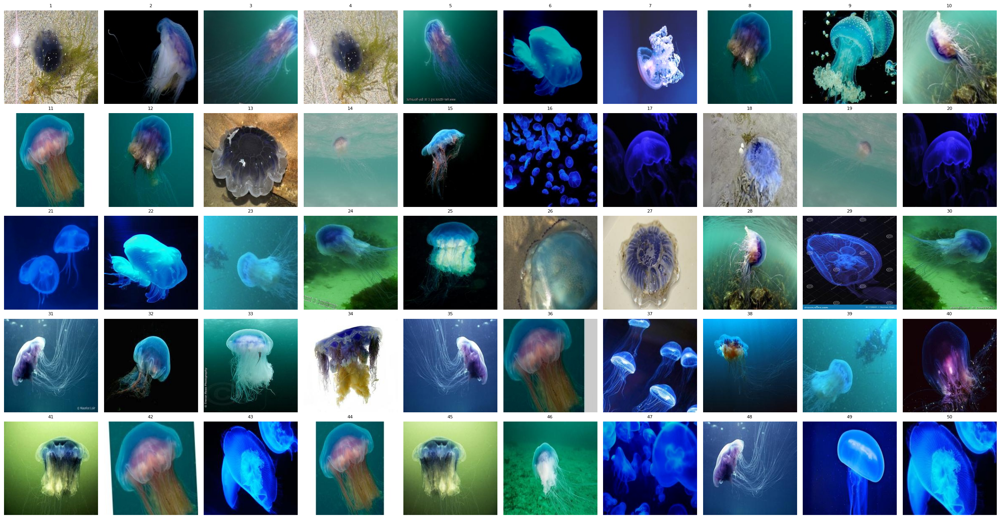

In [25]:
# 해파리 클래스 중 하나 선택
sample_class = "blue_jellyfish"
class_path = os.path.join(train_path, sample_class)

# 파일 목록에서 무작위로 50장 선택 (에러 방지용 min 사용)
image_files = os.listdir(class_path)
num_images = min(50, len(image_files))
sample_images = random.sample(image_files, num_images)

# 시각화 (5행 10열)
plt.figure(figsize=(25, 13))
for i, img_name in enumerate(sample_images):
    img_path = os.path.join(class_path, img_name)
    img = Image.open(img_path)
    plt.subplot(5, 10, i+1)
    plt.imshow(img)
    plt.title(f"{i+1}", fontsize=8)
    plt.axis("off")
plt.tight_layout()
plt.show()


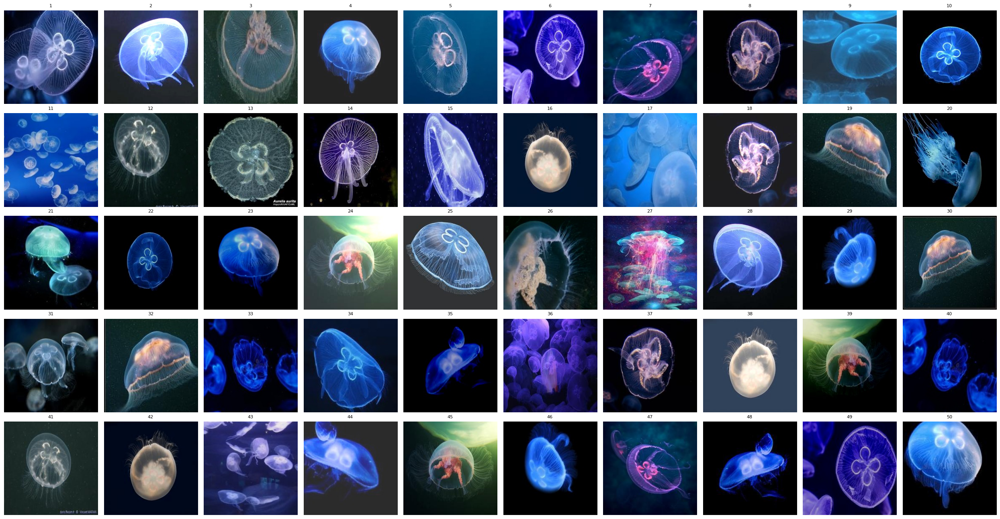

In [26]:
# 해파리 클래스 중 하나 선택
sample_class = "Moon_jellyfish"
class_path = os.path.join(train_path, sample_class)

# 파일 목록에서 무작위로 50장 선택 (에러 방지용 min 사용)
image_files = os.listdir(class_path)
num_images = min(50, len(image_files))
sample_images = random.sample(image_files, num_images)

# 시각화 (5행 10열)
plt.figure(figsize=(25, 13))
for i, img_name in enumerate(sample_images):
    img_path = os.path.join(class_path, img_name)
    img = Image.open(img_path)
    plt.subplot(5, 10, i+1)
    plt.imshow(img)
    plt.title(f"{i+1}", fontsize=8)
    plt.axis("off")
plt.tight_layout()
plt.show()


### 1.1.4 결론

1.   
- **확인 사항:** 해파리 외 판별에 영향을 미칠 다른 요소들이 있는가?
- **결론:** 배경색이 가지각색이라 판별에 영향을 미칠 수 있을 것으로 판단됨
- **대응 전략:** Grad-CAM을 통해서 판별이 가능할 것이나,    
Moon과 Blue jellyfish 를 제외한 모든 해파리는 고유의 색을 가지고 있기 때문에    
선제적으로 대응할 필요는 없을 것으로 보인다.   
추후 추가적인 정확도 향상이 필요할 시 적용 예정.


2.   
- **확인 사항:** 특정 무늬나 형태로 구분할 수 있는 해파리가 있는가?
- **결론:** 모든 해파리는 고유한 형태와 패턴을 가지고있어 판별에 사용할 수 있다.
- **대응 전략:** 텍스처 시각화로 정확도를 높인다.

3.
- **확인 사항:** 색깔로 구분할 수 있는 해파리가 있는가?
- **결론:** 모든 해파리는 고유의 색깔을 가지고 있으나, 이미지의 빛 정도 등에 따라 색상의 왜곡이 있어 판별에 사용하기는 어렵다.
- **대응 전략:** X

4.
- **확인 사항:** 하나의 사진에 해파리가 여러마리 들어있는 경우가 있는가?
- **결론:** 있다.
- **대응 전략:** 하지만 이것이 판별에 영향을 미치는지는 따져볼 필요가 있음.
  - 논문 Deep Learning for Computer Vision (Adrian Rosebrock, PyImageSearch) 및 Stanford CS231n (Fei-Fei Li et al.) – Lecture Notes에 의거하면,   
   **하나의 이미지에 동일 종 해파리가 여러 마리 있어도, 선명하고 명확하면 문제 없음.   
  다만 겹쳐 있거나 중심이 애매한 경우는 노이즈가 됨.**
  - **추후 정확도를 올릴 필요가 있다면, GradCAM을 통해 학습된 모델이 집중하는 부분을 확인 후 대응**

5.
- **추가 확인 사항:** 샘플 중 이미 증강 처리 된 데이터가 있음을 확인
- **대응 전략:** 증강 및 미증강 이미지 수를 확인하고, 데이터 수를 본 후 판단

6.    
- **추가 확인 사항:** blue_jellyfish 샘플 속 moon_jellyfish로 보이는 샘플 다수 발견
- **대응 전략:**    
    1) moon jellyfish를 먼저 학습시킨다.   
    2) blue jellyfish 샘플 중 moon jellyfish로 판별되는 이미지 샘플을 추출하여 제거한다.   
    3) 남은 blue jellyfish 이미지 셋만을 가지고 학습시킨다. (추가 증강 필요)

---

## 1.2 이미지 유사도 확인

### 1.2.1 내용 요약


**[확인 사항]**
- 다른 종이지만 비슷하게 생긴 해파리 확인


**[과정]**
1. **색상** 유사도 확인
    1) 각 이미지의 배경 제거
    2) 클래스 별 3가지 dominant color 추출
    3) 클래스 간 평균 대표 색상끼리 거리(Euclidean) 계산
    4) 유사도 시각화 & 분석

</n>

2. **형태** 유사도 확인
   1) 각 이미지의 배경 제거
   2) 이미지 resize & 흑백으로 변환(grayscale)
   3) HOG descriptor 추출
   4) 클래스 당 여러 이미지 -> 평균 HOG 벡터 생성
   5) 클래스 간 cosine 유사도 계산
   6) 유사도 시각화 & 분석

</n>

3. **텍스처** 유사도 확인
   1) LBP(Local Binary Pattern) 히스토그램 추출
   2) 클래스 별 평균 LBP 히스토그램 생성
   3) 클래스 간 유사도 계산 (Euclidean Distance)
   4) 유사도 시각화 & 분석

### 1.2.2 색상 유사도 확인

In [37]:
classes = [
    "barrel_jellyfish",
    "blue_jellyfish",
    "compass_jellyfish",
    "lions_mane_jellyfish",
    "mauve_stinger_jellyfish",
    "Moon_jellyfish"
]

# 배경 제거 함수
def remove_background_cv2(cv_img):
    pil_img = Image.fromarray(cv2.cvtColor(cv_img, cv2.COLOR_BGR2RGB))
    output = remove(pil_img)
    return cv2.cvtColor(np.array(output), cv2.COLOR_RGBA2RGB)


# dominant color 추출 (대표 색상 3개)
def get_dominant_colors(img, k=3):
    img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    pixels = img_rgb.reshape(-1, 3)
    kmeans = KMeans(n_clusters=k, n_init=10, random_state=42)
    kmeans.fit(pixels)
    return kmeans.cluster_centers_  # (k, 3)

def get_class_representative_color(class_dir, max_images=15, k=3):
    files = [f for f in os.listdir(class_dir) if f.endswith(".jpg") and "aug" not in f]
    dom_colors = []
    for f in tqdm(files[:max_images], desc=os.path.basename(class_dir)):
        img_path = os.path.join(class_dir, f)
        img = cv2.imread(img_path)
        if img is None:
            continue
        try:
            img_nobg = remove_background_cv2(img)
            doms = get_dominant_colors(img_nobg, k=k)
            dom_colors.extend(doms)
        except:
            print(f"⚠️ 배경 제거 실패: {f}")
    if dom_colors:
        return np.mean(dom_colors, axis=0)  # (3,) RGB 평균
    else:
        return np.array([0, 0, 0])  # fallback

Moon_jellyfish: 100%|████████████████████████████████████████████████████████████████████████| 15/15 [00:14<00:00,  1.01it/s]


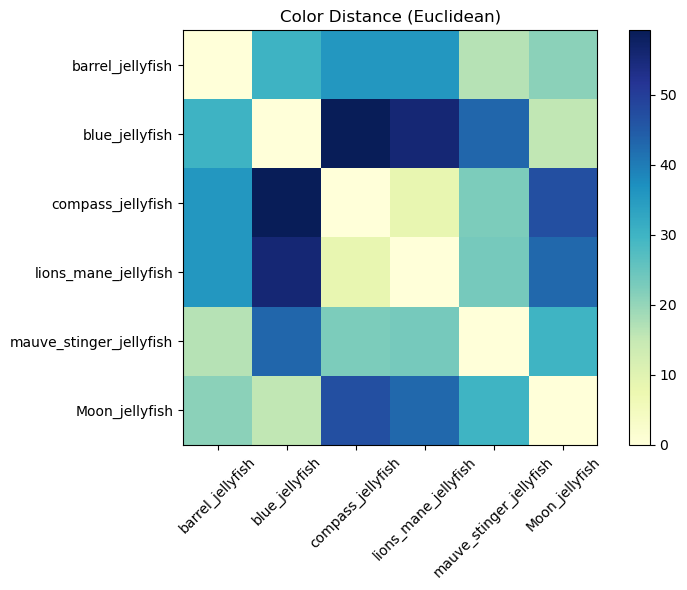


🎨 대표 색상 유사도가 가장 가까운 클래스 TOP 5 (Euclidean 거리):
compass_jellyfish ↔ lions_mane_jellyfish : 거리 = 8.44
blue_jellyfish ↔ Moon_jellyfish : 거리 = 15.29
barrel_jellyfish ↔ mauve_stinger_jellyfish : 거리 = 16.51
barrel_jellyfish ↔ Moon_jellyfish : 거리 = 20.95
compass_jellyfish ↔ mauve_stinger_jellyfish : 거리 = 22.58


In [43]:
# 유사도 분석 및 시각화
def show_similarity_matrix(dist_matrix, labels, title="Color Distance (Euclidean)"):
    plt.figure(figsize=(8, 6))
    plt.imshow(dist_matrix, cmap="YlGnBu")
    plt.title(title)
    plt.colorbar()
    plt.xticks(ticks=np.arange(len(labels)), labels=labels, rotation=45)
    plt.yticks(ticks=np.arange(len(labels)), labels=labels)
    plt.tight_layout()
    plt.show()

def print_most_similar(dist_matrix, labels, top_k=5):
    pairs = []
    for i in range(len(labels)):
        for j in range(i + 1, len(labels)):
            dist = dist_matrix[i, j]
            pairs.append((labels[i], labels[j], dist))
    sorted_pairs = sorted(pairs, key=lambda x: x[2])
    print(f"\n🎨 대표 색상 유사도가 가장 가까운 클래스 TOP {top_k} (Euclidean 거리):")
    for a, b, d in sorted_pairs[:top_k]:
        print(f"{a} ↔ {b} : 거리 = {d:.2f}")

# 실행
if __name__ == "__main__":
    representative_colors = {}
    for cls in classes:
        class_dir = os.path.join(train_path, cls)
        rep_color = get_class_representative_color(class_dir, max_images=15, k=3)
        representative_colors[cls] = rep_color

    labels = list(representative_colors.keys())
    color_matrix = np.array([representative_colors[cls] for cls in labels])
    dist_matrix = euclidean_distances(color_matrix)

    show_similarity_matrix(dist_matrix, labels)
    print_most_similar(dist_matrix, labels)

**[색상 유사도 결론]**

1.    
- **발견 사항:** compass <-> lions_mane (거리 8.44): 매우 유사함.   
- **대응 전략:** 전처리나 모델 설계에서 형태 강조 필요  

2.   
- **발견 사항:** 유사도 15~25 사이의 유사한 색상 그룹 다수
- **대응 전략:** 모델이 형태에 집중하도록 해야할지 판단 필요

### 1.2.3 형태 유사도 확인

In [47]:
# HOG descriptor 추출
def extract_HOG_features(img, resize=(128, 128)):
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    resized = cv2.resize(gray, resize)
    features = hog(resized, orientations=9, pixels_per_cell=(8, 8),
                   cells_per_block=(2, 2), block_norm='L2-Hys', visualize=False)
    return features  # 1D 벡터


#평균 HOG 벡터 생성
def get_class_HOG_average(class_dir, max_images=15):
    files = [f for f in os.listdir(class_dir) if f.endswith(".jpg") and "aug" not in f]
    hogs = []
    for f in tqdm(files[:max_images], desc=os.path.basename(class_dir)):
        img_path = os.path.join(class_dir, f)
        img = cv2.imread(img_path)
        if img is None:
            continue
        try:
            img_nobg = remove_background_cv2(img)
            feat = extract_HOG_features(img_nobg)
            hogs.append(feat)
        except:
            print(f"⚠️ 처리 실패: {f}")
    if hogs:
        return np.mean(hogs, axis=0)
    else:
        return np.zeros((8100,))  # 기본 크기 (128x128 기준)

Moon_jellyfish: 100%|████████████████████████████████████████████████████████████████████████| 15/15 [00:21<00:00,  1.43s/it]


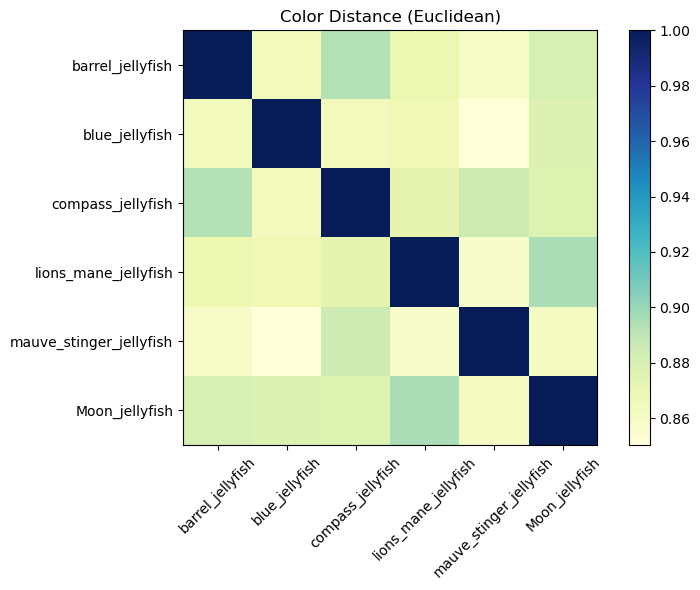


🧱 형태 기반 유사도가 높은 클래스 TOP 5:
lions_mane_jellyfish ↔ Moon_jellyfish : 유사도 = 0.8953
barrel_jellyfish ↔ compass_jellyfish : 유사도 = 0.8925
compass_jellyfish ↔ mauve_stinger_jellyfish : 유사도 = 0.8848
barrel_jellyfish ↔ Moon_jellyfish : 유사도 = 0.8807
blue_jellyfish ↔ Moon_jellyfish : 유사도 = 0.8777


In [51]:
def print_top_similar_pairs(sim_matrix, labels, top_k=5):
    pairs = []
    for i in range(len(labels)):
        for j in range(i + 1, len(labels)):
            sim = sim_matrix[i, j]
            pairs.append((labels[i], labels[j], sim))
    sorted_pairs = sorted(pairs, key=lambda x: -x[2])
    print(f"\n🧱 형태 기반 유사도가 높은 클래스 TOP {top_k}:")
    for a, b, score in sorted_pairs[:top_k]:
        print(f"{a} ↔ {b} : 유사도 = {score:.4f}")

# -----------------------------
# 실행
# -----------------------------
if __name__ == "__main__":
    hog_features = {}
    for cls in classes:
        class_dir = os.path.join(train_path, cls)
        hog_features[cls] = get_class_HOG_average(class_dir, max_images=15)

    labels = list(hog_features.keys())
    hog_matrix = np.array([hog_features[cls] for cls in labels])
    sim_matrix = cosine_similarity(hog_matrix)

    show_similarity_matrix(sim_matrix, labels)
    print_top_similar_pairs(sim_matrix, labels)

**[형태 유사도 결론]**

- **발견 사항:** Moon_jellyfish가 5개 중 3개의 쌍에서 나타남   
- **대응 전략:** 분리 학습 또는 샘플 강조 등 별도 처리 필요  

### 1.2.4 텍스처 유사도 확인

클래스별 LBP 계산: 100%|███████████████████████████████████████████████████████████████████████| 6/6 [00:09<00:00,  1.55s/it]


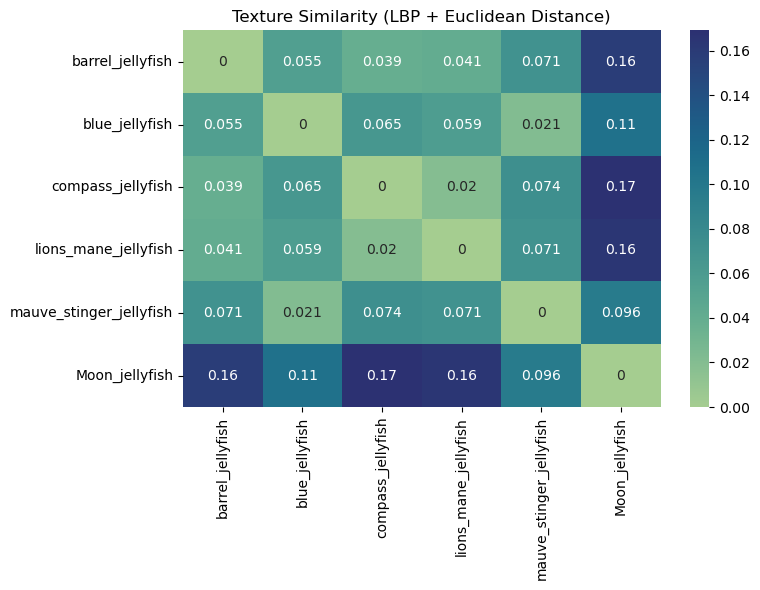

In [91]:
# LBP 설정
LBP_RADIUS = 1
LBP_POINTS = 8 * LBP_RADIUS
LBP_METHOD = 'uniform'

# 클래스 목록
class_names = [
    "barrel_jellyfish",
    "blue_jellyfish",
    "compass_jellyfish",
    "lions_mane_jellyfish",
    "mauve_stinger_jellyfish",
    "Moon_jellyfish"
]

# 이미지 경로 설정
BASE_DIR = "C:/Users/kimho/Dlthon_c1"
IMG_SIZE = (224, 224)

# 클래스별 평균 LBP 히스토그램 계산
def compute_avg_lbp_histograms(base_dir, class_names):
    histograms = {}

    for cls in tqdm(class_names, desc="클래스별 LBP 계산"):
        folder_path = os.path.join(base_dir, cls)
        files = [f for f in os.listdir(folder_path) if f.endswith(('.jpg', '.jpeg', '.png')) and 'aug' not in f]

        lbp_hist_list = []

        for fname in files[:30]:  # 너무 오래 걸리므로 각 클래스당 최대 30장 사용
            img_path = os.path.join(folder_path, fname)
            img = imread(img_path)
            gray = rgb2gray(resize(img, IMG_SIZE))

            lbp = local_binary_pattern(gray, P=LBP_POINTS, R=LBP_RADIUS, method=LBP_METHOD)
            (hist, _) = np.histogram(lbp.ravel(), bins=np.arange(0, LBP_POINTS + 3), range=(0, LBP_POINTS + 2))
            hist = hist.astype("float")
            hist /= (hist.sum() + 1e-6)

            lbp_hist_list.append(hist)

        avg_hist = np.mean(lbp_hist_list, axis=0)
        histograms[cls] = avg_hist

    return histograms

# 클래스 간 유사도(거리) 계산
def compute_texture_similarity(histograms):
    classes = list(histograms.keys())
    n = len(classes)
    distance_matrix = np.zeros((n, n))

    for i in range(n):
        for j in range(n):
            distance_matrix[i, j] = euclidean(histograms[classes[i]], histograms[classes[j]])

    return classes, distance_matrix

# 시각화
def plot_texture_similarity(classes, distance_matrix):
    plt.figure(figsize=(8, 6))
    sns.heatmap(distance_matrix, xticklabels=classes, yticklabels=classes, annot=True, cmap='crest')
    plt.title("Texture Similarity (LBP + Euclidean Distance)")
    plt.tight_layout()
    plt.show()

# 실행
histograms = compute_avg_lbp_histograms(BASE_DIR, class_names)
classes, dist_matrix = compute_texture_similarity(histograms)
plot_texture_similarity(classes, dist_matrix)

**[텍스처 유사도 결론]**

- **발견 사항:**
    - 유클리디안 거리 값이 전반적으로 **매우 낮은 수준 (0.02~0.17)**임
    - 다른 클래스 대비 Moon_jellyfish는 확연히 큰 거리를 보임

</n>

- **대응 전략:**
    - 해파리의 실제 텍스처 패턴(무늬나 선명도)은 배경에 의해 희석되거나 가려질 수 있으므로,   
      **배경 제거**가 필요할 것임
    - Blue_jellyfish 내에 Moon_jellyfish 샘플이 섞여있어   
      모델이 이 두 종을 텍스처 특성 기반으로 혼동할 수 있음.   
      따라서 **Blue_jellyfish 내에서 Moon_jellyfish를 솎아내야 함.**

### 1.2.5 결론

이미지 색상 모두 유사 (모두 euclide distance 50 이하)   
이미지 형태 모두 유사 (모두 85% 이상)   
이미지 텍스처 전반적으로 유사하나, Moon_jellyfish 튐.

따라서 아래 전처리 전략 차용   
- 배경 제거   
- Blue_jellyfish 내에서 Moon_jellyfish를 솎아내기   

----

## 1.3 클래스 별 이미지 수 확인

**[확인 사항]**
  - 클래스 간 이미지 셋의 수를 확인하여 imbalance 확인

                     Class  Total  Original  Augmented
0         barrel_jellyfish    150        41        109
1           blue_jellyfish    150        55         95
2        compass_jellyfish    150        57         93
3     lions_mane_jellyfish    150        61         89
4  mauve_stinger_jellyfish    150        58         92
5           Moon_jellyfish    150        47        103


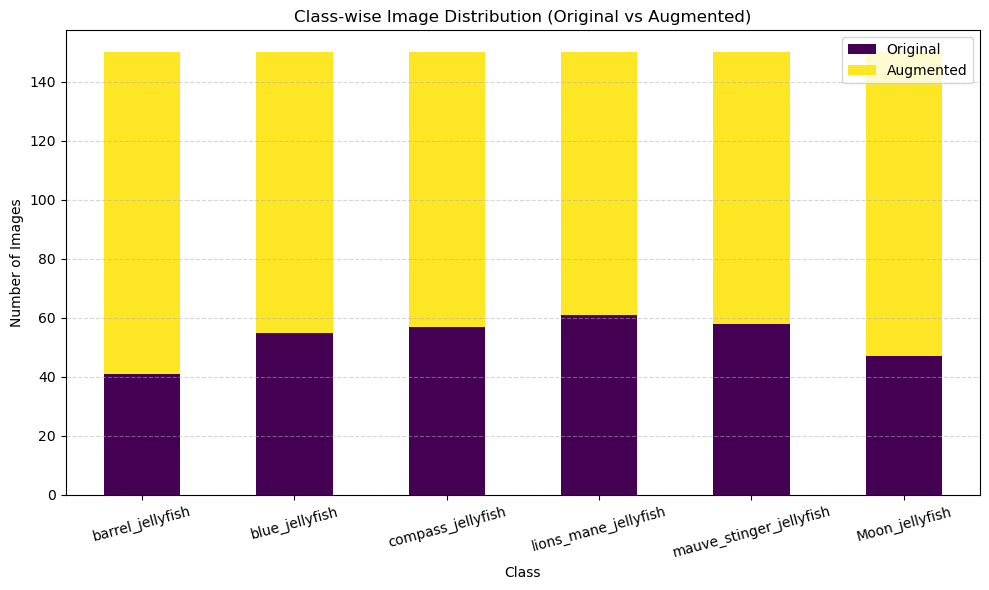

In [49]:
# 이미지 확장자 정의
valid_exts = [".jpg", ".jpeg", ".png"]

# 무시할 폴더
exclude_folders = ['.ipynb_checkpoints', 'Train_Test_Valid']

# 결과 저장용 리스트
class_stats = []

# 클래스별 루프
for class_folder in os.listdir(train_path):
    if class_folder in exclude_folders or not os.path.isdir(os.path.join(train_path, class_folder)):
        continue

    class_path = os.path.join(train_path, class_folder)
    all_files = os.listdir(class_path)

    image_files = [f for f in all_files if os.path.splitext(f)[-1].lower() in valid_exts]
    aug_images = [f for f in image_files if "aug" in f.lower()]
    orig_images = [f for f in image_files if "aug" not in f.lower()]

    class_stats.append({
        "Class": class_folder,
        "Total": len(image_files),
        "Original": len(orig_images),
        "Augmented": len(aug_images)
    })

# DataFrame으로 출력
df_stats = pd.DataFrame(class_stats)
print(df_stats)

# 시각화 (원본 + 증강)
df_stats.set_index("Class")[["Original", "Augmented"]].plot(kind="bar", stacked=True, figsize=(10,6), colormap="viridis")
plt.title("Class-wise Image Distribution (Original vs Augmented)")
plt.ylabel("Number of Images")
plt.xticks(rotation=15)
plt.grid(axis='y', linestyle='--', alpha=0.5)
plt.tight_layout()
plt.show()

### 1.3.1 결론


**확인 사항:** 클래스 별 이미지 수의 imbalance가 존재하는가?   
**결론:**
- 약한 불균형은 존재하지만, 문제 될 정도는 아님.
  - 가장 원본이 적은 클래스는 41장 (27%)
  - 가장 원본이 많은 클래스는 61장 (40%)

**대응 전략:** 큰 문제 없으나, 필요 시 early stopping, val set 기준 평가, mixup 등으로 커버 가능

---
## 1.4 중복 이미지 탐지

### 1.4.1 내용 요약

**[확인 사항]**   
**1. 완전 동일한 이미지 탐지 :** 바이트 해시 (MD5)를 통해 이미지 내용을 바이트 단위로 읽고 hash를 계산해서 비교   
**2. 유사 이미지 탐지 :** Perceptual Hash에서 imagehash 라이브러리를 사용해서 비슷한 이미지를 탐지

**[결과]**
- 완전 중복 이미지 x
- 유사한 이미지 o(66쌍)

### 1.4.2 완전 동일한 이미지 유무 확인
- 완전히 똑같은 이미지는 없음.

In [51]:
def get_file_hash(file_path):
    with open(file_path, "rb") as f:
        return hashlib.md5(f.read()).hexdigest()

hash_dict = {}
dup_files = []

for root, _, files in os.walk(base_path):
    for file in files:
        path = os.path.join(root, file)
        if os.path.splitext(file)[-1].lower() in [".jpg", ".jpeg", ".png"]:  # 이미지 파일만
            file_hash = get_file_hash(path)
            if file_hash in hash_dict:
                dup_files.append((path, hash_dict[file_hash]))
            else:
                hash_dict[file_hash] = path

print(f"완전히 동일한 이미지 수: {len(dup_files)}")
for dup in dup_files:  # 전체 출력
    print(f"중복쌍:\n  {dup[0]}\n  {dup[1]}\n")

완전히 동일한 이미지 수: 0


### 1.4.3 유사한 이미지 있는지 확인
- 66쌍 존재하는 것을 확인함.(유사하는 쌍을 찾도록 함, 증강된 데이터셋이라 유사한 이미지가 2개 아니라, 3개일 수도...? 필요시 추가 확인)
- 쌍으로 페어된 이미지를 나란히 출력하여 확인함.

In [57]:
phash_dict = {}
similar_imgs = []

for root, _, files in os.walk(base_path):
    for file in files:
        path = os.path.join(root, file)
        try:
            if os.path.splitext(file)[-1].lower() in [".jpg", ".jpeg", ".png"]:
                img = Image.open(path).convert("RGB").resize((256, 256))
                phash = imagehash.phash(img)
                if phash in phash_dict:
                    similar_imgs.append((path, phash_dict[phash]))
                else:
                    phash_dict[phash] = path
        except Exception as e:
            print(f"불러오기 실패: {path} ({e})")
            continue

print(f"유사 이미지로 감지된 쌍 수: {len(similar_imgs)}")
for sim in similar_imgs[:5]:
    print(f"유사쌍:\n  {sim[0]}\n  {sim[1]}\n")


유사 이미지로 감지된 쌍 수: 66
유사쌍:
  C:/Users/kimho/Dlthon_c1/Train_Test_Valid\Train\barrel_jellyfish\22.jpg
  C:/Users/kimho/Dlthon_c1/Train_Test_Valid\test\barrel_jellyfish\16.jpg

유사쌍:
  C:/Users/kimho/Dlthon_c1/Train_Test_Valid\Train\barrel_jellyfish\aug-106-31.jpg
  C:/Users/kimho/Dlthon_c1/Train_Test_Valid\Train\barrel_jellyfish\31.jpg

유사쌍:
  C:/Users/kimho/Dlthon_c1/Train_Test_Valid\Train\barrel_jellyfish\aug-107-32.JPG
  C:/Users/kimho/Dlthon_c1/Train_Test_Valid\Train\barrel_jellyfish\32.JPG

유사쌍:
  C:/Users/kimho/Dlthon_c1/Train_Test_Valid\Train\barrel_jellyfish\aug-16-21.jpg
  C:/Users/kimho/Dlthon_c1/Train_Test_Valid\Train\barrel_jellyfish\21.jpg

유사쌍:
  C:/Users/kimho/Dlthon_c1/Train_Test_Valid\Train\barrel_jellyfish\aug-41-01.jpeg
  C:/Users/kimho/Dlthon_c1/Train_Test_Valid\Train\barrel_jellyfish\01.jpeg



#### 유사한 이미지 쌍 출력해보기
- 비슷하다고 판단된 이미지는 약한 데이터 증강으로 추측.
- 유사한 이미지가 학습에 유용할지 방해될지 판단 필요할 수 있음.
- 삭제하거나 병합하면 샘플 수가 줄어든다는 문제 발생.   
 -> 추후 필요하다면, 약한 증강 이미지 삭제 후 샘플 수를 맞춰 재증강 예정

In [ ]:
# 앞에서 감지된 유사 이미지 쌍 리스트: similar_imgs
# 시각화 개수 설정 (예: 10쌍)
num_to_display = min(30, len(similar_imgs)) # 수를 수정하여 출력 쌍의 개수를 조절 가능.

for i in range(num_to_display):
    img_path1, img_path2 = similar_imgs[i]

    img1 = Image.open(img_path1)
    img2 = Image.open(img_path2)

    plt.figure(figsize=(8, 4))
    plt.suptitle(f"similar images {i+1}")

    plt.subplot(1, 2, 1)
    plt.imshow(img1)
    plt.title("Image 1")
    plt.axis("off")

    plt.subplot(1, 2, 2)
    plt.imshow(img2)
    plt.title("Image 2")
    plt.axis("off")

    plt.tight_layout()
    plt.show()


----
## 1.5 이미지 품질 확인

### 1.5.1 내용 요약

**[확인 사항]**   
**1. 이미지 품질 확인**(저품질의 데이터를 학습시키면 모델 품질 또한 저하될 우려가 있으므로)   

**[결과]**


In [83]:
# 설정
valid_exts = [".jpg", ".jpeg", ".png"]
exclude_folders = ['.ipynb_checkpoints', 'Train_Test_Valid']

# 결과 저장용 리스트
image_quality_stats = []

# 클래스별 순회
for class_folder in os.listdir(train_path):
    if class_folder in exclude_folders or not os.path.isdir(os.path.join(train_path, class_folder)):
        continue

    class_path = os.path.join(train_path, class_folder)

    for img_name in tqdm(os.listdir(class_path), desc=f"{class_folder}"):
        if "aug" in img_name.lower():
            continue  # 증강 이미지 제외
        if not os.path.splitext(img_name)[-1].lower() in valid_exts:
            continue

        img_path = os.path.join(class_path, img_name)
        img = cv2.imread(img_path)

        if img is None:
            continue

        # 해상도
        height, width = img.shape[:2]

        # 블러 측정 (Laplacian variance)
        gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
        blur_score = cv2.Laplacian(gray, cv2.CV_64F).var()

        # 밝기 측정 (Mean pixel intensity)
        brightness = np.mean(gray)

        image_quality_stats.append({
            "Class": class_folder,
            "Image": img_name,
            "Width": width,
            "Height": height,
            "BlurScore": blur_score,
            "Brightness": brightness
        })

# 결과를 DataFrame으로
df_quality = pd.DataFrame(image_quality_stats)

# 품질 낮은 이미지(흐린) 예시 출력 (blur 낮은 순)
print("\n저품질(흐린) 이미지:")
print(df_quality.sort_values("BlurScore").head(10))

# 너무 어두운 이미지 확인
dark_imgs = df_quality[df_quality["Brightness"] < 30]
print("\n어두운 이미지:")
print(dark_imgs)

Moon_jellyfish: 100%|████████████████████████████████████████████████████████████████████| 150/150 [00:00<00:00, 2529.45it/s]


저품질(흐린) 이미지:
                       Class   Image  Width  Height  BlurScore  Brightness
71            blue_jellyfish  43.jpg    224     224  20.655034  148.350646
235  mauve_stinger_jellyfish  28.jpg    224     224  26.350968   83.180843
48            blue_jellyfish  11.jpg    224     224  35.319192   13.710678
285           Moon_jellyfish  18.jpg    224     224  39.590727   39.107681
59            blue_jellyfish  28.jpg    224     224  39.991350   38.622389
17          barrel_jellyfish  22.jpg    224     224  43.967907  146.725745
14          barrel_jellyfish  18.jpg    224     224  45.339422  156.200076
36          barrel_jellyfish  45.jpg    224     224  53.095840  102.897381
7           barrel_jellyfish  10.jpg    224     224  62.822046  121.940310
79            blue_jellyfish  53.jpg    224     224  66.218120   35.171217

어두운 이미지:
                       Class   Image  Width  Height    BlurScore  Brightness
43            blue_jellyfish  04.jpg    224     224   211.711694   22.1169

#### 어두운 이미지 시각화

**why?**
- 해파리 자체는 밝은데 배경이 어두운 경우일 수 있음
    - 해파리가 잘 보이면 ok
    - 해파리까지 어두우면 제거 후보

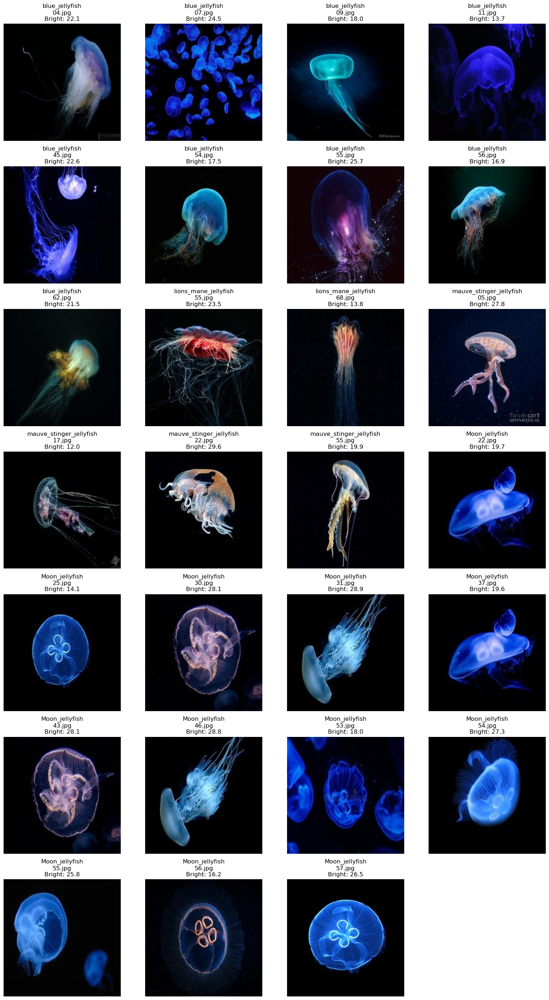

In [89]:
# 어두운 이미지 샘플 시각화

# 밝기 임계값
BRIGHTNESS_THRESHOLD = 30

# 어두운 이미지 필터링
dark_imgs = df_quality[df_quality["Brightness"] < BRIGHTNESS_THRESHOLD].reset_index(drop=True)

# 시각화
num_imgs = len(dark_imgs)
cols = 4
rows = (num_imgs + cols - 1) // cols

plt.figure(figsize=(cols * 4, rows * 4))
for i, row in enumerate(dark_imgs.itertuples()):
    img_path = os.path.join(train_path, row.Class, row.Image)
    img = cv2.imread(img_path)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

    plt.subplot(rows, cols, i + 1)
    plt.imshow(img)
    plt.title(f"{row.Class}\n{row.Image}\nBright: {row.Brightness:.1f}")
    plt.axis("off")

plt.tight_layout()
plt.show()

### 1.5.2 결론

**확인 사항:** 이미지 품질 확인(저품질의 데이터를 학습시키면 모델 품질 또한 저하될 우려가 있으므로)   
**결론:**
- 모든 저품질(흐리거나 어두움) 이미지는 원본에서 나타났음
- 흐린 이미지의 경우, 총 900개 데이터 중 10개에 불과하기 때문에 큰 영향을 미치지 않을 것으로 판단됨
- 어두운 이미지의 경우, 모든 데이터가 배경만 어두우며, 해파리 자체는 밝음

**대응 전략:** 흐린 이미지 & 어두운 이미지 모두 그대로 사용

----
## 1.6 EDA 결론 및 전처리 전략 설계

1. 배경색 제거

</n>

2. blue jellyfish 데이터셋 내에 moon jellyfish가 들어있는 문제
   1) moon jellyfish 선학습
   2) moon jellyfish 모델로 blue jellyfish 내의 이미지 판별
   3) moon jellyfish라고 판별 된 이미지 제거 후 나머지 이미지 증강   

</n>

3. (확인 후 대응) 텍스처 시각화
   - 색상, 형태 모두 유사도가 높았음. 남은 건 텍스처 뿐.

</n>

4. (확인 후 대응) 한 이미지 내에 복수 해파리가 있는 경우 대응 필요할지 판단

</n>

5. (사후 대응) 학습 데이터셋이 부족한 경우 추가 증강

</n>

6. (사후 대응) 66쌍의 약한 증강을 거친 유사 이미지 셋에 대해,
   - 추후 모델의 정확도 개선이 어렵고 과적합이 빠르게 높아진다면,
     중복 이미지를 제거한 후 재증강 예정.

-----
# 2. 데이터 전처리

## 2.1 배경색 제거

In [62]:
# 처리할 폴더 목록
input_folders = [
    top_path + "/barrel_jellyfish",
    top_path + "/blue_jellyfish",
    top_path + "/compass_jellyfish",
    top_path + "/lions_mane_jellyfish",
    top_path + "/mauve_stinger_jellyfish",
    top_path + "/Moon_jellyfish"
]

# 각 폴더의 이미지를 처리하는 함수
def process_folder(input_folder):
    # 출력 폴더 생성 (원본 폴더명_remove_background)
    output_folder = f"{input_folder}_remove_background"
    
    # 출력 폴더가 없으면 생성
    if not os.path.exists(output_folder):
        os.makedirs(output_folder)
    
    # 폴더 내 이미지 파일 가져오기
    image_files = [f for f in os.listdir(input_folder) if f.endswith((".png", ".jpg", ".jpeg",".PNG",".JPG"))]
    
    print(f"폴더 '{input_folder}'에서 {len(image_files)}개 이미지 처리 시작...")
    
    # 각 이미지 파일 처리
    for img_file in image_files:
        input_path = os.path.join(input_folder, img_file)
        
        # 출력 파일명 (JPG로 저장)
        output_filename = os.path.splitext(img_file)[0] + ".jpg"
        output_path = os.path.join(output_folder, output_filename)
        
        try:
            # 이미지 로드 및 배경 제거
            with open(input_path, "rb") as input_file:
                with open(output_path, "wb") as output_file:
                    input_image = input_file.read()
                    output_image = remove(
                        input_image,
                        alpha_matting=True,
                        alpha_matting_foreground_threshold=220,
                        alpha_matting_background_threshold=20,)
                    output_file.write(output_image)
            
            print(f"  ✓ {img_file} 처리 완료")
        except Exception as e:
            print(f"  ✗ {img_file} 처리 중 오류 발생: {str(e)}")
    
    print(f"폴더 '{input_folder}' 처리 완료!\n")

# 모든 폴더 처리
for folder in input_folders:
    if os.path.exists(folder) and os.path.isdir(folder):
        process_folder(folder)
    else:
        print(f"경고: '{folder}' 폴더가 존재하지 않습니다.")

print("모든 폴더의 이미지 배경 제거 작업이 완료되었습니다!")

폴더 'C:/Users/kimho/Dlthon_c1/barrel_jellyfish'에서 150개 이미지 처리 시작...
  ✓ 01.jpeg 처리 완료
  ✓ 02.jpg 처리 완료
  ✓ 03.jpg 처리 완료
  ✓ 04.jpg 처리 완료
PERFORMANCE WARNING:
Thresholded incomplete Cholesky decomposition failed due to insufficient positive-definiteness of matrix A with parameters:
    discard_threshold = 1.000000e-04
    shift = 0.000000e+00
Try decreasing discard_threshold or start with a larger shift

  ✓ 05.jpg 처리 완료
  ✓ 06.jpg 처리 완료
  ✓ 07.jpg 처리 완료
  ✓ 10.jpg 처리 완료
  ✓ 11.jpg 처리 완료
  ✓ 12.jpg 처리 완료
  ✓ 13.jpg 처리 완료
  ✓ 14.jpg 처리 완료
  ✓ 15.jpg 처리 완료
  ✓ 17.jpg 처리 완료
  ✓ 18.jpg 처리 완료
  ✓ 20.jpg 처리 완료
  ✓ 21.jpg 처리 완료
  ✓ 22.jpg 처리 완료
  ✓ 24.jpg 처리 완료
  ✓ 25.jpg 처리 완료
  ✓ 27.jpg 처리 완료
  ✓ 28.jpg 처리 완료
  ✓ 29.jpg 처리 완료
  ✓ 30.jpg 처리 완료
  ✓ 31.jpg 처리 완료
  ✓ 32.JPG 처리 완료
  ✓ 33.jpg 처리 완료
  ✓ 34.jpg 처리 완료
  ✓ 35.jpg 처리 완료
  ✓ 36.jpg 처리 완료
  ✓ 37.jpg 처리 완료
  ✓ 38.jpg 처리 완료
  ✓ 39.JPG 처리 완료
  ✓ 40.jpg 처리 완료
  ✓ 41.jpg 처리 완료
  ✓ 42.jpg 처리 완료
  ✓ 45.jpg 처리 완료
  ✓ 46.jpg 처리 완료
  ✓ 47.jpg 처리 완료

----
## 2.2 blue jellyfish 데이터셋에서 moon jellyfish 골라내기

### 2.2.0 내용 요약

#### **[모델 선택 전략]**
|항목|선택 사항|선택 이유|
|--|--|--|
|**모델**|MobileNetV2 (imagenet pretrained)|- 경량 모델이라 학습 빠르고 </br> - 작은 데이터셋에서도 과적합 덜함 </br> - 이미지 분류에 널리 검증됨|
|**구조**|head만 추가: GlobalPool → Dense(64) → Dense(1, sigmoid)|표현력 + 경량성 밸런스|

#### **[분류 전략]**
|항목|설명|
|--|--|
|0~1 출력|sigmoid 결과값 → moon일 확률|
|판별 기준값 (threshold)|기본 0.5 사용 (moon일 확률 > 50%)|
|추가 검증|이미지를 뽑아서 육안으로 확인 후, threshold 조정|

In [ ]:
# ✅ 경로 설정
top_path = Path(top_path)
temp_base_path = Path(base_path)
temp_path = temp_base_path / "moon_clean_tmp"
moon_path = top_path / "Moon_jellyfish"
blue_path = top_path / "blue_jellyfish"


# ✅ Step 1: binary classification용 임시 데이터셋 생성
def prepare_binary_dataset(moon_path, blue_path, img_size=(224,224), batch_size=32):
    shutil.rmtree(temp_path, ignore_errors=True)
    os.makedirs(temp_path / 'moon', exist_ok=True)
    os.makedirs(temp_path / 'notmoon', exist_ok=True)

    for fname in os.listdir(moon_path):
        if fname.endswith('.jpg'):
            shutil.copy(moon_path / fname, temp_path / 'moon' / fname)

    blue_imgs = [f for f in os.listdir(blue_path) if f.endswith('.jpg')]
    for fname in blue_imgs[:50]:  # 일부만 notmoon
        shutil.copy(blue_path / fname, temp_path / 'notmoon' / fname)

    return image_dataset_from_directory(
        temp_path,
        label_mode='int',
        image_size=img_size,
        batch_size=batch_size
    )


# ✅ Step 2: MobileNetV2 기반 분류기 학습
def train_moon_classifier(dataset):
    base_model = MobileNetV2(include_top=False, input_shape=(224,224,3), weights='imagenet')
    base_model.trainable = False

    model = models.Sequential([
        base_model,
        layers.GlobalAveragePooling2D(),
        layers.Dense(64, activation='relu'),
        layers.Dense(1, activation='sigmoid')
    ])

    model.compile(optimizer='adam', loss='binary_crossentropy', metrics=['accuracy'])
    model.fit(dataset, epochs=5, verbose=2)
    return model


# ✅ Step 4: moon 확률 높은 이미지 예측 및 시각화
def visualize_top_moon_predictions(model, blue_path, top_n=50, img_size=(224,224)):
    preds = []

    for fname in tqdm(os.listdir(blue_path)):
        if not fname.endswith('.jpg'):
            continue
        fpath = blue_path / fname
        img = load_img(fpath, target_size=img_size)
        arr = img_to_array(img) / 255.0
        pred = model.predict(np.expand_dims(arr, axis=0), verbose=0)[0][0]
        preds.append((fpath, pred, img))  # (경로, 확률, 원본 이미지)

    preds.sort(key=lambda x: x[1], reverse=True)  # 확률 높은 순 정렬

    print(f"\n📸 Moon 확률 높은 상위 {top_n}개 이미지:")
    plt.figure(figsize=(20, int(top_n/5) * 4))
    for i, (fpath, prob, img) in enumerate(preds[:top_n]):
        plt.subplot(int(np.ceil(top_n/5)), 5, i+1)
        plt.imshow(img)
        plt.title(f"{fpath.name}\nmoon: {prob:.2f}", fontsize=10)
        plt.axis('off')
    plt.tight_layout()
    plt.show()

    return preds


# 데이터셋 준비
ds = prepare_binary_dataset(moon_path, blue_path)

# 모델 학습
moon_model = train_moon_classifier(ds)

# 예측 + 상위 moon 이미지 시각화
top_preds = visualize_top_moon_predictions(moon_model, blue_path, top_n=50)📸 Moon 확률 높은 상위 50개 이미지:


## 2.3 발견 사항 및 대응 전략

(코드 용량 이슈로 캡처본으로 대체)
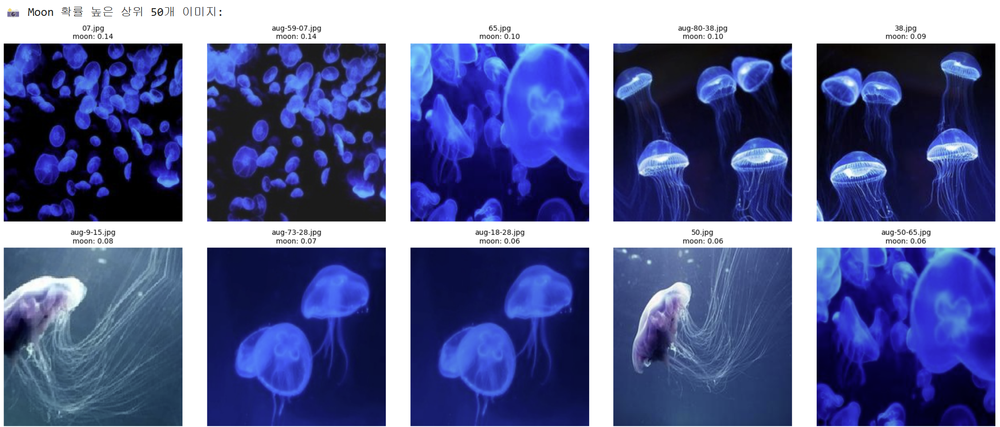

- moon jellyfish 일 확률 상위 10개 이미지를 보았을 때 **대체적으로 잘 골라냄**   
- 하지만 **일부 blue jellyfish로 추정되는 것이 섞여있음**
- 또한, moon 추정 확률 또한 **1위가 9%로** 매우 낮음

따라서, 모든 이미지를 눈으로 확인 후 수작업으로 골라냄.

**moon jellyfish 판별 기준:**
- 보수적인 판별을 위해, 우산 내부에 말굽 모양 생식선 존재할 경우만 선택

🔍 제거된 이미지 수 (moon 판단): 17
✅ 남은 원본 이미지 수: 131

🗑️ 제거된 이미지 리스트:
 - 03.jpg
 - 07.jpg
 - 28.jpg
 - 32.jpg
 - 34.jpg
 - 65.jpg
 - aug-1-03.jpg
 - aug-18-28.jpg
 - aug-21-32.jpg
 - aug-22-34.jpg
 - aug-4-07.jpg
 - aug-50-65.jpg
 - aug-56-03.jpg
 - aug-59-07.jpg
 - aug-73-28.jpg
 - aug-76-32.jpg
 - aug-77-34.jpg

🖼️ 제거된 이미지 시각화:


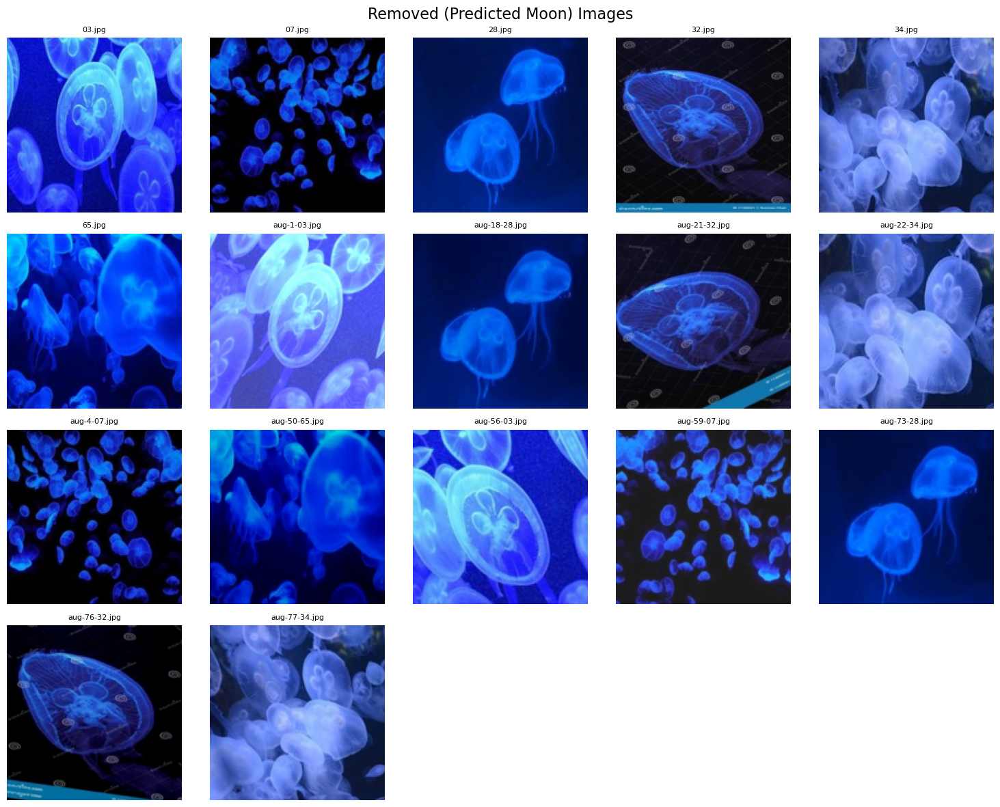

In [18]:
# ✅ 경로 설정
moon_ids = {"03", "07", "28", "32", "34", "65"}  # 제거 대상 숫자
blue_raw_path = Path(top_path) / "blue_jellyfish"
blue_clean_path = Path(top_path) / "blue_jellyfish_clean"
blue_clean_path.mkdir(parents=True, exist_ok=True)

# ✅ Step 1: moon으로 추정되는 이미지 제거
retained_images = []
removed_images = []
removed_count = 0

for fname in os.listdir(blue_raw_path):
    if not fname.lower().endswith('.jpg'):
        continue

    stem = fname.split('.')[0]  # "05", "aug-1-07" 등
    parts = stem.split('-')
    check = parts[-1]  # 마지막 숫자만 추출 (e.g., "07")

    if check in moon_ids:
        removed_images.append(fname)
        removed_count += 1
    else:
        retained_images.append(fname)

print(f"🔍 제거된 이미지 수 (moon 판단): {removed_count}")
print(f"✅ 남은 원본 이미지 수: {len(retained_images)}")

# 👉 제거된 이미지 출력
print("\n🗑️ 제거된 이미지 리스트:")
for f in removed_images:
    print(" -", f)

# 📸 이미지 시각화 함수
def show_images_from_list(img_dir, img_list, title, ncols=5, img_size=(150, 150)):
    n_imgs = len(img_list)
    nrows = (n_imgs + ncols - 1) // ncols
    plt.figure(figsize=(ncols * 3, nrows * 3))
    for idx, fname in enumerate(img_list):
        img_path = img_dir / fname
        if not img_path.exists(): continue
        img = Image.open(img_path).resize(img_size)
        plt.subplot(nrows, ncols, idx + 1)
        plt.imshow(img)
        plt.title(fname, fontsize=8)
        plt.axis('off')
    plt.suptitle(title, fontsize=16)
    plt.tight_layout()
    plt.show()

# 🔍 제거된 이미지 시각화
print("\n🖼️ 제거된 이미지 시각화:")
show_images_from_list(blue_raw_path, removed_images, "Removed (Predicted Moon) Images")

----
## 2.3 한 이미지 내 중복 개체가 있는 경우 제거

### 2.3.0 내용 요약
- 탐구 내용 : 
    1. 구조 간단한 CNN 모델에서 샘플 이미지 배경의 유무, 
    2. 한 이미지에 여러 마리의 해파리가 존재할 때 모델 학습에 영향을 미치는지,
    3. 4개의 데이터셋을 각각 학습한 모델의 성능을 비교하고,
    - 배경 ㅇ / 복수 객체 ㅇ
    - 배경 ㅇ / 복수 객체 x
    - 배경 x / 복수 객체 ㅇ
    - 배경 x / 복수 객체 x
    4. Grad-CAM을 통해 분석해보기.
    

### 2.3.1 복수 객체 포함된 이미지를 제거 및 다양한 데이터셋 만들기
- [배경 ㅇ / 복수 객체 ㅇ] 기본 데이터셋 사용.
- [배경 ㅇ / 복수 객체 x] 육안으로 확인되는 복수 객체 포함한 샘플을 수동으로 제거함.
- [배경 x / 복수 객체 ㅇ] 배경 제거 전처리한 데이터셋을 사용.
- [배경 x / 복수 객체 x] 배경 제거 전처리한 데이터셋에서 육안으로 복수 객체 포함한 샘플을 수동으로 제거함.

**샘플 제거 기준**
- 비슷한 크기의 객체가 복수 존재 시 무조건 제거.
- 샘플 이미지에 완전한 객체 하나 + 가장자리에 애매하게 다른 객체가 보일 경우는 보류함.

### 2.3.2 CNN 모델 구성 및 학습

In [10]:
IMG_SIZE = 224
BATCH_SIZE = 32

# 데이터셋 1) 배경 ㅇ / 복수 객체 ㅇ
train_ds = tf.keras.utils.image_dataset_from_directory(
    base_path + "/Train",
    image_size=(IMG_SIZE, IMG_SIZE),
    batch_size=BATCH_SIZE
)

val_ds = tf.keras.utils.image_dataset_from_directory(
    base_path + "/valid",
    image_size=(IMG_SIZE, IMG_SIZE),
    batch_size=BATCH_SIZE
)

test_ds = tf.keras.utils.image_dataset_from_directory(
    base_path + "/test",
    image_size=(IMG_SIZE, IMG_SIZE),
    batch_size=BATCH_SIZE
)

# 데이터 최적화(성능 향상)
AUTOTUNE = tf.data.AUTOTUNE
train_ds = train_ds.cache().shuffle(1000).prefetch(buffer_size=AUTOTUNE) # 한 번 읽은 데이터는 메모리에 저장하여 재사용, 학습 순서를 섰어 편향 학습 방지. 
val_ds = val_ds.cache().prefetch(buffer_size=AUTOTUNE) # 학습 도중 다음 배치 미리 준비 -> 병럴 처리로 GPU 효율 증가.
test_ds = test_ds.cache().prefetch(buffer_size=AUTOTUNE)


Found 900 files belonging to 6 classes.
Found 39 files belonging to 6 classes.
Found 40 files belonging to 6 classes.


Epoch 1/35
26/26 [==============================] - 3s 75ms/step - loss: 2.5652 - accuracy: 0.3121 - val_loss: 1.7881 - val_accuracy: 0.1282

Epoch 00001: val_accuracy improved from -inf to 0.12821, saving model to best_model8.h5
Epoch 2/35
26/26 [==============================] - 2s 67ms/step - loss: 1.3496 - accuracy: 0.4529 - val_loss: 1.7947 - val_accuracy: 0.1282

Epoch 00002: val_accuracy did not improve from 0.12821
Epoch 3/35
26/26 [==============================] - 2s 67ms/step - loss: 1.1559 - accuracy: 0.5251 - val_loss: 1.8348 - val_accuracy: 0.1282

Epoch 00003: val_accuracy did not improve from 0.12821
Epoch 4/35
26/26 [==============================] - 2s 67ms/step - loss: 1.0181 - accuracy: 0.5838 - val_loss: 1.8095 - val_accuracy: 0.2051

Epoch 00004: val_accuracy improved from 0.12821 to 0.20513, saving model to best_model8.h5
Epoch 5/35
26/26 [==============================] - 2s 67ms/step - loss: 0.9001 - accuracy: 0.6536 - val_loss: 1.7820 - val_accuracy: 0.2051

E

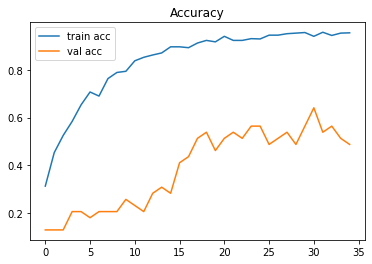

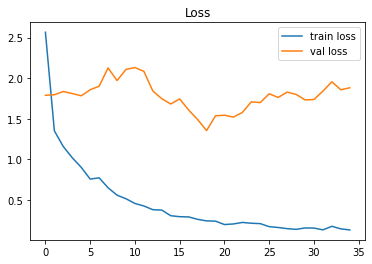

2/2 [==============================] - 0s 8ms/step - loss: 1.7693 - accuracy: 0.4750
Test accuracy: 0.4750, Test loss: 1.7693
                         precision    recall  f1-score   support

       barrel_jellyfish       0.60      0.50      0.55         6
         blue_jellyfish       0.36      1.00      0.53         5
      compass_jellyfish       0.50      0.14      0.22         7
   lions_mane_jellyfish       0.75      0.43      0.55         7
mauve_stinger_jellyfish       0.50      0.38      0.43         8
         Moon_jellyfish       0.44      0.57      0.50         7

               accuracy                           0.48        40
              macro avg       0.53      0.50      0.46        40
           weighted avg       0.53      0.47      0.46        40



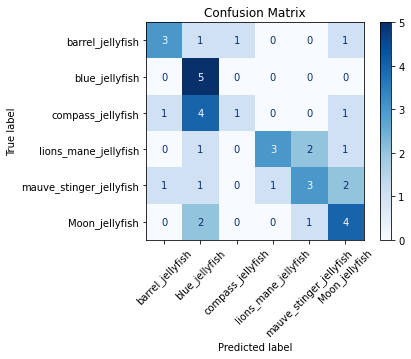

In [12]:
model_8 = models.Sequential([
    # 0~255 픽셀을 0~1로 정규화
    layers.Rescaling(1./255, input_shape=(IMG_SIZE, IMG_SIZE, 3)),

    # 첫 번째 블록
    layers.Conv2D(32, (3,3), padding='same'),
    layers.BatchNormalization(),
    layers.Activation('relu'),
    layers.MaxPooling2D((2,2)),

    # 두 번째 블록
    layers.Conv2D(64, (3,3), padding='same'),
    layers.BatchNormalization(),
    layers.Activation('relu'),
    layers.MaxPooling2D((2,2)),

    # 세 번째 블록 추가 (새로 추가)
    layers.Conv2D(128, (3,3), padding='same'),
    layers.BatchNormalization(),
    layers.Activation('relu'),
    layers.MaxPooling2D((2,2)),

    # Fully connected layers
    layers.Flatten(),
    layers.Dense(128, activation='relu'),
    layers.Dropout(0.3),  # dropout 다시 활성화 (오버피팅 방지)
    layers.Dense(6, activation='softmax')  # 클래스 수: 6개
])

# 컴파일
model_8.compile(
    optimizer=Adam(learning_rate=1e-4),  # 학습률 낮춤
    loss='sparse_categorical_crossentropy',
    metrics=['accuracy']
)

# 콜백 설정: val_accuracy 기준으로 최고 성능 모델 저장
checkpoint = ModelCheckpoint('best_model8.h5', monitor='val_accuracy', 
                             save_best_only=True, mode='max', verbose=1)

history = model_8.fit(
    train_ds,
    validation_data=val_ds,
    epochs=35,
    callbacks=[checkpoint]
)

plt.plot(history.history['accuracy'], label='train acc')
plt.plot(history.history['val_accuracy'], label='val acc')
plt.title('Accuracy')
plt.legend()
plt.show()

plt.plot(history.history['loss'], label='train loss')
plt.plot(history.history['val_loss'], label='val loss')
plt.title('Loss')
plt.legend()
plt.show()

test_loss, test_acc = model_8.evaluate(test_ds)
print(f"Test accuracy: {test_acc:.4f}, Test loss: {test_loss:.4f}")

from sklearn.metrics import classification_report, confusion_matrix, ConfusionMatrixDisplay
# 예측 수행
y_pred = []
y_true = []

for images, labels in test_ds:
    preds = model_8.predict(images, verbose=0)
    y_pred.extend(np.argmax(preds, axis=1))
    y_true.extend(labels.numpy())

# 클래스 목록
class_names = [
    "barrel_jellyfish",
    "blue_jellyfish",
    "compass_jellyfish",
    "lions_mane_jellyfish",
    "mauve_stinger_jellyfish",
    "Moon_jellyfish"
]

# Classification Report 출력
print(classification_report(y_true, y_pred, target_names=class_names))

# Confusion Matrix 시각화
cm = confusion_matrix(y_true, y_pred)
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=class_names)
disp.plot(xticks_rotation=45, cmap='Blues')
plt.title("Confusion Matrix")
plt.show()

Found 817 files belonging to 6 classes.
Epoch 1/35
26/26 [==============================] - 3s 75ms/step - loss: 3.0508 - accuracy: 0.3170 - val_loss: 1.7843 - val_accuracy: 0.1282

Epoch 00001: val_accuracy improved from -inf to 0.12821, saving model to best_model9.h5
Epoch 2/35
26/26 [==============================] - 2s 68ms/step - loss: 1.3871 - accuracy: 0.4247 - val_loss: 1.8603 - val_accuracy: 0.2051

Epoch 00002: val_accuracy improved from 0.12821 to 0.20513, saving model to best_model9.h5
Epoch 3/35
26/26 [==============================] - 2s 68ms/step - loss: 1.2431 - accuracy: 0.4871 - val_loss: 1.9488 - val_accuracy: 0.1538

Epoch 00003: val_accuracy did not improve from 0.20513
Epoch 4/35
26/26 [==============================] - 2s 68ms/step - loss: 1.0772 - accuracy: 0.5569 - val_loss: 2.0352 - val_accuracy: 0.1282

Epoch 00004: val_accuracy did not improve from 0.20513
Epoch 5/35
26/26 [==============================] - 2s 68ms/step - loss: 0.9649 - accuracy: 0.5961 - va

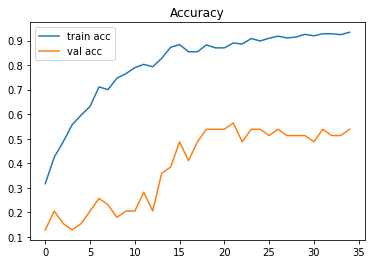

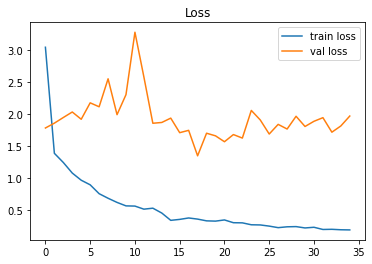

2/2 [==============================] - 0s 9ms/step - loss: 1.7578 - accuracy: 0.5000
Test accuracy: 0.5000, Test loss: 1.7578
                         precision    recall  f1-score   support

       barrel_jellyfish       0.75      0.50      0.60         6
         blue_jellyfish       0.31      0.80      0.44         5
      compass_jellyfish       0.67      0.29      0.40         7
   lions_mane_jellyfish       0.50      0.43      0.46         7
mauve_stinger_jellyfish       0.80      0.50      0.62         8
         Moon_jellyfish       0.44      0.57      0.50         7

               accuracy                           0.50        40
              macro avg       0.58      0.51      0.50        40
           weighted avg       0.59      0.50      0.51        40



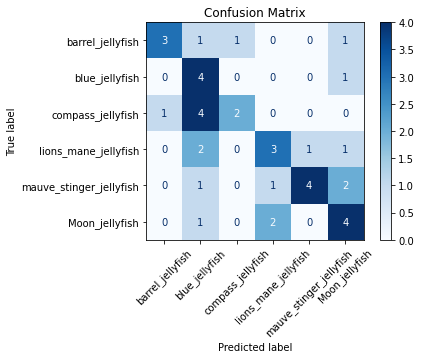

In [13]:
# 훈련데이터셋 2) 배경 ㅇ / 복수 객체 x
train_ds = tf.keras.utils.image_dataset_from_directory(
    base_path + "/Train_single",
    image_size=(IMG_SIZE, IMG_SIZE),
    batch_size=BATCH_SIZE
)

# 데이터 최적화(성능 향상)
AUTOTUNE = tf.data.AUTOTUNE
train_ds = train_ds.cache().shuffle(1000).prefetch(buffer_size=AUTOTUNE) # 한 번 읽은 데이터는 메모리에 저장하여 재사용, 학습 순서를 섰어 편향 학습 방지. 
val_ds = val_ds.cache().prefetch(buffer_size=AUTOTUNE) # 학습 도중 다음 배치 미리 준비 -> 병럴 처리로 GPU 효율 증가.
test_ds = test_ds.cache().prefetch(buffer_size=AUTOTUNE)

model_9 = models.Sequential([
    # 0~255 픽셀을 0~1로 정규화
    layers.Rescaling(1./255, input_shape=(IMG_SIZE, IMG_SIZE, 3)),

    # 첫 번째 블록
    layers.Conv2D(32, (3,3), padding='same'),
    layers.BatchNormalization(),
    layers.Activation('relu'),
    layers.MaxPooling2D((2,2)),

    # 두 번째 블록
    layers.Conv2D(64, (3,3), padding='same'),
    layers.BatchNormalization(),
    layers.Activation('relu'),
    layers.MaxPooling2D((2,2)),

    # 세 번째 블록 추가 (새로 추가)
    layers.Conv2D(128, (3,3), padding='same'),
    layers.BatchNormalization(),
    layers.Activation('relu'),
    layers.MaxPooling2D((2,2)),

    # Fully connected layers
    layers.Flatten(),
    layers.Dense(128, activation='relu'),
    layers.Dropout(0.3),  # dropout 다시 활성화 (오버피팅 방지)
    layers.Dense(6, activation='softmax')  # 클래스 수: 6개
])

# 컴파일
model_9.compile(
    optimizer=Adam(learning_rate=1e-4),  # 학습률 낮춤
    loss='sparse_categorical_crossentropy',
    metrics=['accuracy']
)

# 콜백 설정: val_accuracy 기준으로 최고 성능 모델 저장
checkpoint = ModelCheckpoint('best_model9.h5', monitor='val_accuracy', 
                             save_best_only=True, mode='max', verbose=1)

history = model_9.fit(
    train_ds,
    validation_data=val_ds,
    epochs=35,
    callbacks=[checkpoint]
)

plt.plot(history.history['accuracy'], label='train acc')
plt.plot(history.history['val_accuracy'], label='val acc')
plt.title('Accuracy')
plt.legend()
plt.show()

plt.plot(history.history['loss'], label='train loss')
plt.plot(history.history['val_loss'], label='val loss')
plt.title('Loss')
plt.legend()
plt.show()

test_loss, test_acc = model_9.evaluate(test_ds)
print(f"Test accuracy: {test_acc:.4f}, Test loss: {test_loss:.4f}")

# 예측 수행
y_pred = []
y_true = []

for images, labels in test_ds:
    preds = model_9.predict(images, verbose=0)
    y_pred.extend(np.argmax(preds, axis=1))
    y_true.extend(labels.numpy())

# Classification Report 출력
print(classification_report(y_true, y_pred, target_names=class_names))

# Confusion Matrix 시각화
cm = confusion_matrix(y_true, y_pred)
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=class_names)
disp.plot(xticks_rotation=45, cmap='Blues')
plt.title("Confusion Matrix")
plt.show()

### 이상 내용을 *두 번 더 반복*하여 **[배경 x / 복수 객체 ㅇ], [배경 x / 복수 객체 x] 데이터셋을 학습**한다.
내용을 요약하기 위해 이미지로 첨부

### 2.3.3 Grad-Cam 시각화
- 4개의 데이터 셋으로 학습한 모델들이 복수 객체 존재하는 이미지에 대해서 어떻게 반응을 하는지 확인하기 위해,
- Grad-CAM 및 heatmap을 시각화하여 분석해보기.

In [15]:
# 모델의 마지막 conv2D layer의 이름을 확인 -> !!! 모델 학습 시킬 때 마다 레이어 이름 확인 필수.
# 시각화 할 때 입력 필요!!!
model_8.summary()
print('#'*60)
model_9.summary()

Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
rescaling_1 (Rescaling)      (None, 224, 224, 3)       0         
_________________________________________________________________
conv2d_3 (Conv2D)            (None, 224, 224, 32)      896       
_________________________________________________________________
batch_normalization_3 (Batch (None, 224, 224, 32)      128       
_________________________________________________________________
activation_3 (Activation)    (None, 224, 224, 32)      0         
_________________________________________________________________
max_pooling2d_3 (MaxPooling2 (None, 112, 112, 32)      0         
_________________________________________________________________
conv2d_4 (Conv2D)            (None, 112, 112, 64)      18496     
_________________________________________________________________
batch_normalization_4 (Batch (None, 112, 112, 64)     

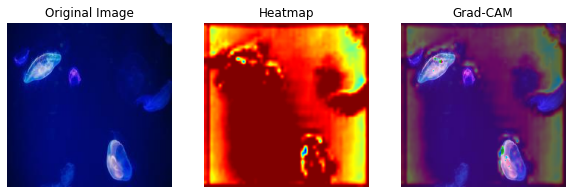

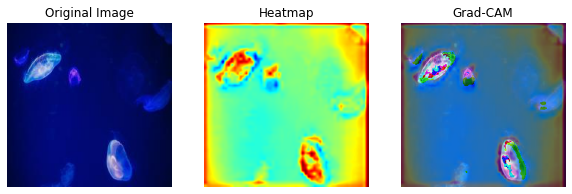

In [34]:
def get_img_array(img_path, size):
    img = image.load_img(img_path, target_size=size)
    array = image.img_to_array(img)
    array = np.expand_dims(array, axis=0)
    return array

def make_gradcam_heatmap(img_array, model, last_conv_layer_name, pred_index=None):
    # 마지막 합성곱 층을 가져옵니다.
    last_conv_layer = model.get_layer(last_conv_layer_name)
    
    # 모델에서 마지막 합성곱 층의 출력과 모델의 예측값을 동시에 반환하는 새로운 모델을 생성합니다.
    grad_model = tf.keras.models.Model(
        [model.inputs],
        [last_conv_layer.output, model.output]
    )
    
    # 그라디언트를 기록하기 위한 GradientTape 사용
    with tf.GradientTape() as tape:
        conv_outputs, predictions = grad_model(img_array)
        if pred_index is None:
            pred_index = tf.argmax(predictions[0])
        class_channel = predictions[:, pred_index]
    
    # 마지막 합성곱 층의 출력에 대한 기울기를 계산합니다.
    grads = tape.gradient(class_channel, conv_outputs)
    
    # 각 필터의 중요도를 평균내어 가중치를 얻습니다.
    pooled_grads = tf.reduce_mean(grads, axis=(0, 1, 2))
    
    # 각 필터에 대해 가중치를 곱합니다.
    conv_outputs = conv_outputs[0]
    heatmap = conv_outputs @ pooled_grads[..., tf.newaxis]
    heatmap = tf.squeeze(heatmap)
    
    # 0~1 사이로 스케일링
    heatmap = tf.maximum(heatmap, 0) / tf.math.reduce_max(heatmap)
    return heatmap.numpy()

# 이미지 경로와 사이즈
img_path = "/aiffel/aiffel/jellyfish/Train_Test_Valid/test/blue_jellyfish/01.jpeg"  # 분석할 이미지 파일 경로
IMG_SIZE = (224, 224)

# 이미지 배열 변환
img_array = get_img_array(img_path, IMG_SIZE)

model = model_8
last_conv_layer_name = "conv2d_5"  # MobileNetV2의 마지막 합성곱 층 이름 (모델에 따라 다름)

# Grad-CAM heatmap 생성
heatmap = make_gradcam_heatmap(img_array, model, last_conv_layer_name)

# 원본 이미지 로드
img = image.load_img(img_path, target_size=IMG_SIZE)
img = image.img_to_array(img)

# heatmap을 원본 이미지에 오버레이
import cv2
heatmap = cv2.resize(heatmap, (img.shape[1], img.shape[0]))
heatmap = np.uint8(255 * heatmap)
heatmap = cv2.applyColorMap(heatmap, cv2.COLORMAP_JET)
superimposed_img = heatmap * 0.4 + img

plt.figure(figsize=(10, 10))
plt.subplot(1, 3, 1)
plt.title("Original Image")
plt.imshow(img.astype("uint8"))
plt.axis("off")

plt.subplot(1, 3, 2)
plt.title("Heatmap")
plt.imshow(heatmap)
plt.axis("off")

plt.subplot(1, 3, 3)
plt.title("Grad-CAM")
plt.imshow(superimposed_img.astype("uint8"))
plt.axis("off")
plt.show()

#####################

model = model_9
last_conv_layer_name = "conv2d_8"  # MobileNetV2의 마지막 합성곱 층 이름 (모델에 따라 다름)

# Grad-CAM heatmap 생성
heatmap = make_gradcam_heatmap(img_array, model, last_conv_layer_name)

# 원본 이미지 로드
img = image.load_img(img_path, target_size=IMG_SIZE)
img = image.img_to_array(img)

# heatmap을 원본 이미지에 오버레이
import cv2
heatmap = cv2.resize(heatmap, (img.shape[1], img.shape[0]))
heatmap = np.uint8(255 * heatmap)
heatmap = cv2.applyColorMap(heatmap, cv2.COLORMAP_JET)
superimposed_img = heatmap * 0.4 + img

plt.figure(figsize=(10, 10))
plt.subplot(1, 3, 1)
plt.title("Original Image")
plt.imshow(img.astype("uint8"))
plt.axis("off")

plt.subplot(1, 3, 2)
plt.title("Heatmap")
plt.imshow(heatmap)
plt.axis("off")

plt.subplot(1, 3, 3)
plt.title("Grad-CAM")
plt.imshow(superimposed_img.astype("uint8"))
plt.axis("off")
plt.show()

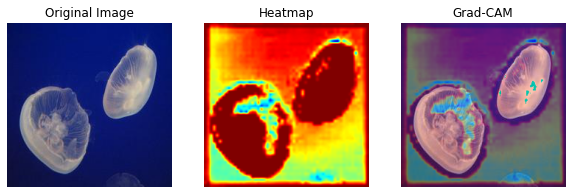

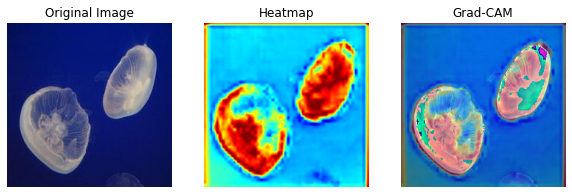

In [35]:
# 이미지 경로와 사이즈
img_path = "/aiffel/aiffel/jellyfish/Train_Test_Valid/test/Moon_jellyfish/07.JPG"
IMG_SIZE = (224, 224)

# 이미지 배열 변환
img_array = get_img_array(img_path, IMG_SIZE)

model = model_8
last_conv_layer_name = "conv2d_5"  # MobileNetV2의 마지막 합성곱 층 이름 (모델에 따라 다름)

# Grad-CAM heatmap 생성
heatmap = make_gradcam_heatmap(img_array, model, last_conv_layer_name)

# 원본 이미지 로드
img = image.load_img(img_path, target_size=IMG_SIZE)
img = image.img_to_array(img)

# heatmap을 원본 이미지에 오버레이
import cv2
heatmap = cv2.resize(heatmap, (img.shape[1], img.shape[0]))
heatmap = np.uint8(255 * heatmap)
heatmap = cv2.applyColorMap(heatmap, cv2.COLORMAP_JET)
superimposed_img = heatmap * 0.4 + img

plt.figure(figsize=(10, 10))
plt.subplot(1, 3, 1)
plt.title("Original Image")
plt.imshow(img.astype("uint8"))
plt.axis("off")

plt.subplot(1, 3, 2)
plt.title("Heatmap")
plt.imshow(heatmap)
plt.axis("off")

plt.subplot(1, 3, 3)
plt.title("Grad-CAM")
plt.imshow(superimposed_img.astype("uint8"))
plt.axis("off")
plt.show()

#####################

model = model_9
last_conv_layer_name = "conv2d_8"  # MobileNetV2의 마지막 합성곱 층 이름 (모델에 따라 다름)

# Grad-CAM heatmap 생성
heatmap = make_gradcam_heatmap(img_array, model, last_conv_layer_name)

# 원본 이미지 로드
img = image.load_img(img_path, target_size=IMG_SIZE)
img = image.img_to_array(img)

# heatmap을 원본 이미지에 오버레이
import cv2
heatmap = cv2.resize(heatmap, (img.shape[1], img.shape[0]))
heatmap = np.uint8(255 * heatmap)
heatmap = cv2.applyColorMap(heatmap, cv2.COLORMAP_JET)
superimposed_img = heatmap * 0.4 + img

plt.figure(figsize=(10, 10))
plt.subplot(1, 3, 1)
plt.title("Original Image")
plt.imshow(img.astype("uint8"))
plt.axis("off")

plt.subplot(1, 3, 2)
plt.title("Heatmap")
plt.imshow(heatmap)
plt.axis("off")

plt.subplot(1, 3, 3)
plt.title("Grad-CAM")
plt.imshow(superimposed_img.astype("uint8"))
plt.axis("off")
plt.show()

#### 이미지 배경 제거한 데이터셋(복수 객체 이미지 포함)으로 model_10 학습
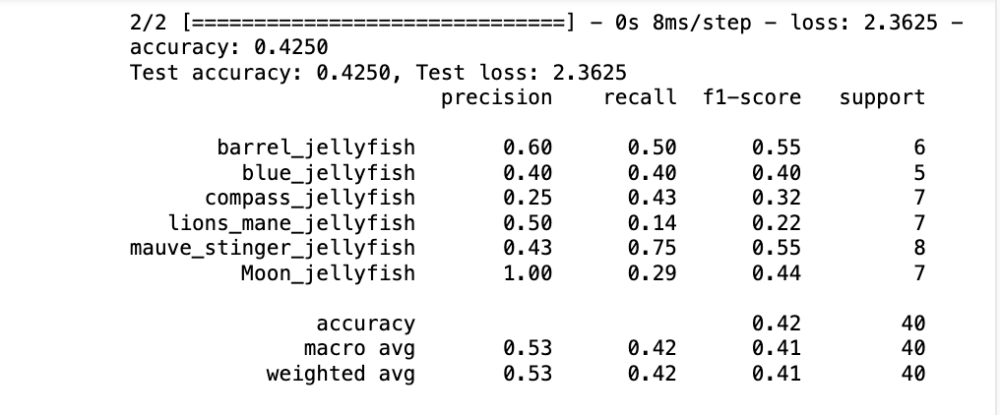
#### 이미지 배경 제거한 데이터셋(복수 객체 이미지 포함)으로 model_11 학습
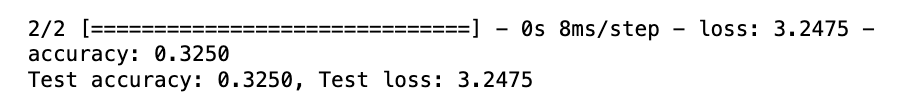
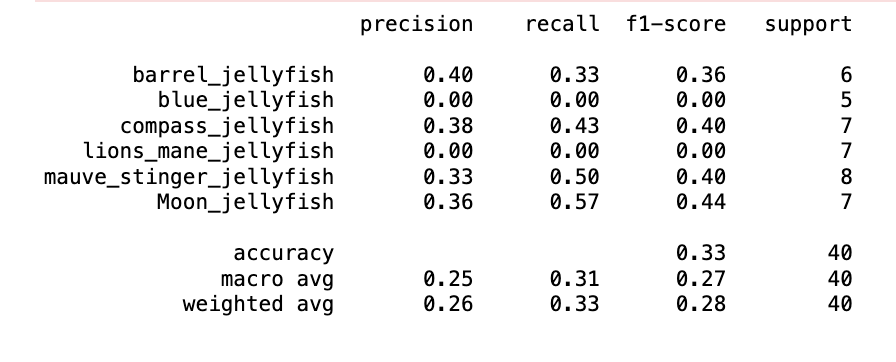

### model_10 & model_11의 Grad-CAM 시각화 결과
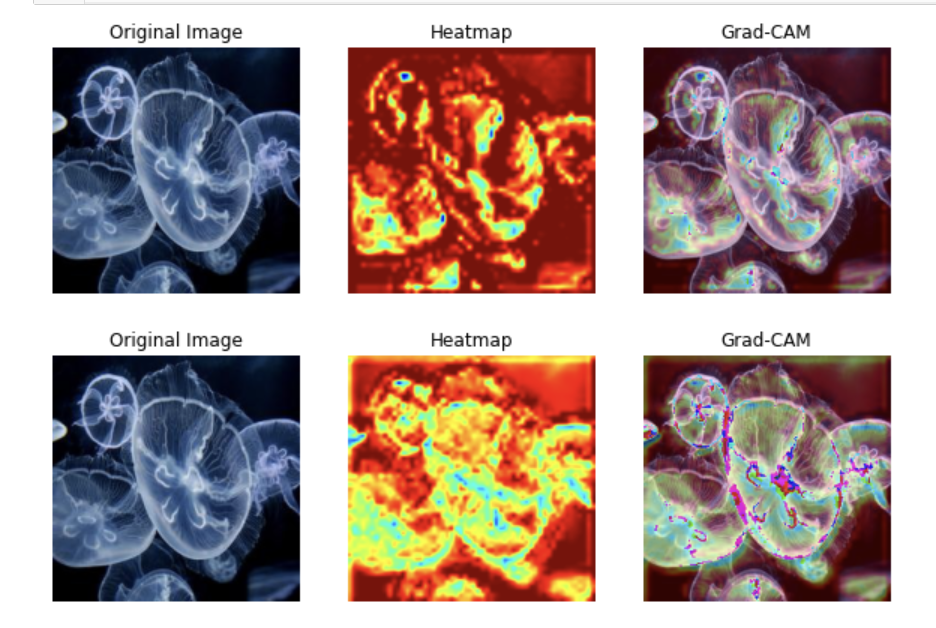
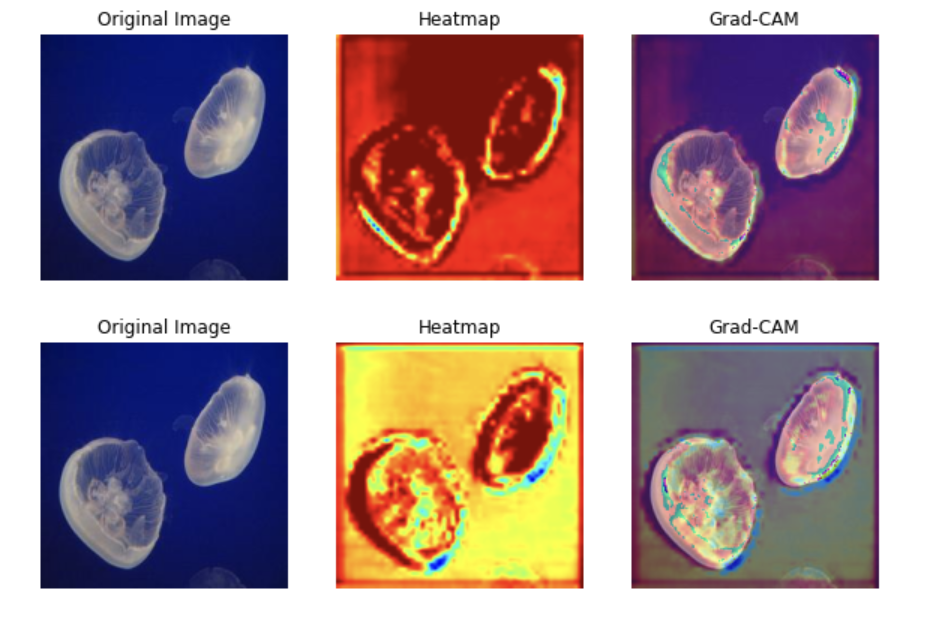 

### [결론]
- 배경 ㅇ / 복수 객체 ㅇ
- 배경 ㅇ / 복수 객체 x
- 배경 x / 복수 객체 ㅇ
- 배경 x / 복수 객체 x
1. 이상 4가지 데이터 셋으로 학습한 모델의 성능을 비교해보면

    - 배경 있는 샘플로 학습했을 때 정확도 조금 더 높게 나온다.
    - 복수 객체 샘플을 제외했을 때 모델이 학습한 결과로 객체에 더 잘 집중되고 인식한다.
2. 배경을 제거했을 때 데이터에 있는 정보가 손실되어 학습에 영향을 미친다. -> 정확도(성능) 낮아짐.
3. 복수 객체 샘플의 존재가 모델 학습에 영향을 미치는 것을 확인함.
4. 배경 제처 처리 여부에 따라 모델 학습에 영향을 미치는 것을 확인함.
-> 모델의 성능을 향상하려면 이부분에서 개선할 수 있을 것 같다.

## 2.4 제거한 이미지 수량만큼 증강

**[증강 전략]**

- 중복 없이 증강 대상 랜덤 선택   
    - 밝은 이미지 또는 증강 수가 적은 이미지 선택 고려했으나,   
    - 특정 이미지를 과도하게 증강하는 경우가 발생하여 랜덤으로 증강 대상 선정.

----
# 3. Baseline 모델 설계

## 3.0 모델 돌아보기

### 3.0.1 후보 모델 목록

#### 1. CNN
   - **특징:** 전통적인 Conv → ReLU → Pool 구조 기반의 단순한 CNN
   - **장점:** 구조 이해가 쉬움, 빠른 실험 가능
   - **단점:** 성능 한계 명확
#### 2. mobilenet v2
   - **특징:** 경량화 모델 (모바일용)
   - **장점:** 빠름, 극소량의 자원에서도 학습 가능
   - **단점:** 성능 ceiling 낮음
#### 3. mobilenet v3
   - **특징:** Depthwise Separable Conv + Squeeze-Excite + NAS 기반 경량 구조 (모바일, 경량)
   - **장점:** 빠름, 적은 자원에서도 작동
   - **단점:** 표현력 한계 있음, 중간 복잡도의 태스크에서 성능 ceiling 존재
#### 4. ConvNext
   - **특징:** 최신 CNN 계열 (ViT 스타일 구조 도입)	
   - **장점:** 최신성, 성능 좋음	
   - **단점:** 무거움, baseline으론 과할 수도
#### 5. Resnet50
   - **특징:** skip connection으로 딥러닝 안정화
   - **장점:** 높은 성능, 빠른 수렴
   - **단점:** 구조 복잡도 다소 있음
#### 6. EfficientNet(5개 다 성과 잘 안나왔을 때 후보...)
   - **특징:** 계산량 대비 정확도 최고 수준
   - **장점:** 가볍고 성능 좋음 (SOTA 계열)	
   - **단점:** 구조가 black-box 느낌 있음

### 3.0.2 베이스라인 모델 요구 사항 정리 및 모델 선택

#### **[베이스라인 모델 요구사항]**
1. **데이터 특성과 모델 구조 간의 적합성**   
   Jellyfish 데이터셋은 클래스 간 색상과 형태의 유사성이 높고,   
   데이터 수가 제한적이기 때문에,   
   지나치게 깊거나 복잡한 모델은 과적합 우려가 있음.   
   -> 적당한 표현력과 경량성의 균형이 맞는 모델 필요
   
2. **모델 경량성과 실험 효율성**   
   베이스라인이므로, 빠른 실험 사이클을 가능하게 하며   
   적절한 수준의 성능까지 보장하는 모델 필요


#### **[베이스라인 모델 선택]**
요구사항의 두가지 기준을 고려하여, 해당 조건을 모두 만족시킬 수 있는   
**MobileNetV3** 로 베이스라인 모델 선정.

### 3.0.3 모든 모델에서 확인할 핵심 아웃풋 지표

|지표|설명|베이스라인 선택에 미치는 영향|
|---|---|---|
|Confusion Matrix|어떤 클래스에서 자주 틀리는지|형태 vs 색상 헷갈림 여부 분석|
|GradCAM|모델이 어디를 보고 분류했는가|모델이 의미 있는 영역 보는지 확인|
|학습 곡선|Overfitting or underfitting 빠르게 확인|복잡도에 비해 충분한 학습이 되는지|

### 3.0.4 모델 구성 및 학습 구조 변화


|항목|1단계|2단계|주요 차이점|
|---|---|---|---|
|베이스 모델 훈련|전체|동결|마지막 5개 층 해동|미세 조정 가능|
|Dense 층 크기|128 노드|256 노드|모델 용량 증가|
|Dropout 위치|출력 직전|Dense(256) 이후|규제 위치 변경|
|학습률|0.001|0.0001|보수적인 업데이트|
|EarlyStopping|5에포크|7에포크|더 긴 관찰 기간|

In [ ]:
# 1단계
base_model = tf.keras.applications.MobileNetV3Large(
    input_shape=(224, 224, 3), include_top=False, weights='imagenet'
)
base_model.trainable = False  

# 사용자 정의 분류기 추가
model = models.Sequential([
    base_model,
    layers.GlobalAveragePooling2D(),
    layers.BatchNormalization(),
    layers.Dense(128, activation='relu'),
    layers.BatchNormalization(),
    layers.Dropout(0.5),
    layers.Dense(len(class_names), activation='softmax')  

# 모델 컴파일
model.compile(
    optimizer=tf.keras.optimizers.Adam(learning_rate=0.001),
    loss='sparse_categorical_crossentropy',
    metrics=['accuracy']
)

model.summary()

callbacks = [
    tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=5, restore_best_weights=True),
    tf.keras.callbacks.ReduceLROnPlateau(monitor='val_loss', factor=0.2, patience=2, min_lr=1e-5)
]

history = model.fit(
    train_ds,
    validation_data=valid_ds,
    epochs=15,
    callbacks=callbacks
)

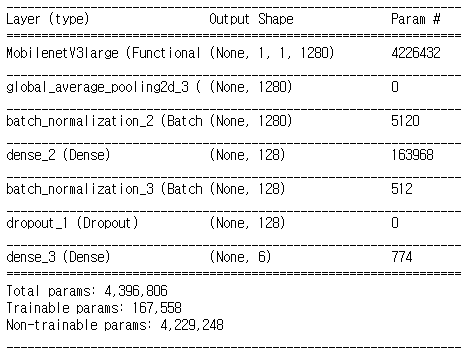

In [ ]:
# 2단계
base_model = tf.keras.applications.MobileNetV3Large(
    input_shape=(224, 224, 3), include_top=False, weights='imagenet'
)
base_model.trainable = True
for layer in base_model.layers[:-5]:
    layer.trainable = False

# 사용자 정의 분류기 추가
model = models.Sequential([
    base_model,
    layers.GlobalAveragePooling2D(),
    layers.BatchNormalization(),
    layers.Dense(256, activation='relu'),   
    layers.Dropout(0.5),  
    layers.Dense(len(class_names), activation='softmax')  
])

# 모델 컴파일 및 학습
model.compile(
    optimizer=tf.keras.optimizers.Adam(learning_rate=0.0001),
    loss='sparse_categorical_crossentropy',
    metrics=['accuracy']
)

model.summary()

callbacks = [
    tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=7, restore_best_weights=True),
    tf.keras.callbacks.ReduceLROnPlateau(monitor='val_loss', factor=0.2, patience=3, min_lr=1e-5)
]

history = model.fit(
    train_ds,
    validation_data=valid_ds,
    epochs=15,
    callbacks=callbacks
)

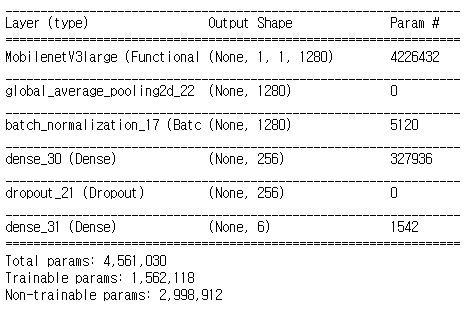

#### 내용요약
기본 데이터 성능 검증
- 테스트 손실: 0.4510
- 테스트 정확도: 0.8750

배경제거 데이터 성능 검증
- 테스트 손실: 0.7254
- 테스트 정확도: 0.7250

한 이미지 내에 여러 개체가 있는 경우를 제거한 데이터 성능검증
- 테스트 손실: 0.4337
- 테스트 정확도: 0.8750

----
## 3.1 기본 데이터 성능 검증 - MobileNetV3

#### 데이터 준비

In [66]:
# 이미지 파일 경로와 레이블 수집 함수
def get_files_labels(directory):
    # 지원하는 이미지 확장자 목록
    if not isinstance(directory, Path):
        directory = Path(directory)
    image_extensions = ["*.jpg","*.JPG","*.PNG ","*.jpeg", "*.png"]
    
    # 모든 확장자를 포함한 파일 수집
    all_files = []
    for ext in image_extensions:
        all_files.extend(directory.rglob(ext))
    
    file_paths = [str(f) for f in all_files]
    labels = [f.parent.name for f in all_files]
    return file_paths, labels

# 데이터셋별 파일 경로 및 레이블 로드
X_train, y_train = get_files_labels(train_path)
X_val, y_val = get_files_labels(valid_path)
X_test, y_test = get_files_labels(test_path)

print(f"Train 데이터: {len(X_train)}개")
print(f"Validation 데이터: {len(X_val)}개")
print(f"Test 데이터: {len(X_test)}개")

Train 데이터: 900개
Validation 데이터: 39개
Test 데이터: 40개


#### 이미지 전처리

In [67]:
# 클래스 이름 정의 및 매핑 생성
class_names = sorted(set(y_train + y_val + y_test))
class_to_idx = {cls: i for i, cls in enumerate(class_names)}

# 이미지를 로드하고 전처리하는 함수 정의
def load_image(path):
    img = tf.io.read_file(path)
    img = tf.image.decode_jpeg(img, channels=3)
    img = tf.image.resize(img, [224, 224])  # MobileNetV3 입력 크기
    return tf.keras.applications.mobilenet_v3.preprocess_input(img)

# TensorFlow Dataset 생성 함수 정의
def create_tf_dataset(paths, labels):
    labels = [class_to_idx[label] for label in labels]
    dataset = tf.data.Dataset.from_tensor_slices((paths, labels))
    dataset = dataset.map(lambda p, l: (load_image(p), l))  # 이미지 로드 및 전처리 적용
    return dataset

# Train/Validation/Test 데이터셋 생성
train_ds = create_tf_dataset(X_train, y_train).shuffle(1000).batch(32).prefetch(2)
valid_ds = create_tf_dataset(X_val, y_val).batch(32).prefetch(2)
test_ds = create_tf_dataset(X_test, y_test).batch(32)

#### 모델 구성

In [68]:
# MobileNetV3Large 로드
base_model = tf.keras.applications.MobileNetV3Large(
    input_shape=(224, 224, 3), include_top=False, weights='imagenet'
)
base_model.trainable = True
for layer in base_model.layers[:-5]:
    layer.trainable = False

# 사용자 정의 분류기 추가
model = models.Sequential([
    base_model,
    layers.GlobalAveragePooling2D(),
    layers.BatchNormalization(),
    layers.Dense(256, activation='relu'),  # 노드 수 증가  
    layers.Dropout(0.5),  # Dropout 비율 조정
    layers.Dense(len(class_names), activation='softmax')  # 클래스 출력층
])

# 모델 컴파일 및 학습
model.compile(
    optimizer=tf.keras.optimizers.Adam(learning_rate=0.0001),
    loss='sparse_categorical_crossentropy',
    metrics=['accuracy']
)

model.summary()

Model: "sequential_10"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
MobilenetV3large (Functional (None, 1, 1, 1280)        4226432   
_________________________________________________________________
global_average_pooling2d_22  (None, 1280)              0         
_________________________________________________________________
batch_normalization_17 (Batc (None, 1280)              5120      
_________________________________________________________________
dense_30 (Dense)             (None, 256)               327936    
_________________________________________________________________
dropout_21 (Dropout)         (None, 256)               0         
_________________________________________________________________
dense_31 (Dense)             (None, 6)                 1542      
Total params: 4,561,030
Trainable params: 1,562,118
Non-trainable params: 2,998,912
___________________________________

#### 모델 학습

In [69]:
callbacks = [
    tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=7, restore_best_weights=True),
    tf.keras.callbacks.ReduceLROnPlateau(monitor='val_loss', factor=0.2, patience=3, min_lr=1e-5)
]

history = model.fit(
    train_ds,
    validation_data=valid_ds,
    epochs=15,
    callbacks=callbacks
)

Epoch 1/15
29/29 [==============================] - 6s 76ms/step - loss: 1.6815 - accuracy: 0.4333 - val_loss: 1.1283 - val_accuracy: 0.6923
Epoch 2/15
29/29 [==============================] - 2s 41ms/step - loss: 0.6653 - accuracy: 0.7811 - val_loss: 0.9185 - val_accuracy: 0.6923
Epoch 3/15
29/29 [==============================] - 2s 39ms/step - loss: 0.3571 - accuracy: 0.8856 - val_loss: 0.8167 - val_accuracy: 0.7692
Epoch 4/15
29/29 [==============================] - 2s 40ms/step - loss: 0.2796 - accuracy: 0.8989 - val_loss: 0.7803 - val_accuracy: 0.8205
Epoch 5/15
29/29 [==============================] - 2s 40ms/step - loss: 0.1963 - accuracy: 0.9411 - val_loss: 0.7529 - val_accuracy: 0.8462
Epoch 6/15
29/29 [==============================] - 2s 40ms/step - loss: 0.1424 - accuracy: 0.9644 - val_loss: 0.7390 - val_accuracy: 0.8205
Epoch 7/15
29/29 [==============================] - 2s 40ms/step - loss: 0.1170 - accuracy: 0.9778 - val_loss: 0.7491 - val_accuracy: 0.8205
Epoch 8/15
29

#### 결과 시각화

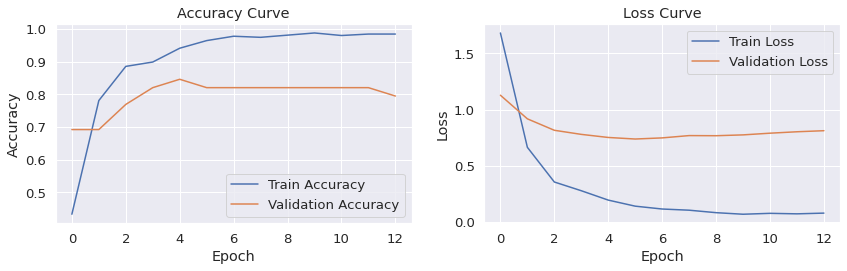

In [70]:
plt.figure(figsize=(12, 4))

# 정확도 곡선 시각화
plt.subplot(1, 2, 1)
plt.plot(history.history['accuracy'], label='Train Accuracy')
plt.plot(history.history['val_accuracy'], label='Validation Accuracy')
plt.title('Accuracy Curve')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.legend()

# 손실 곡선 시각화
plt.subplot(1, 2, 2)
plt.plot(history.history['loss'], label='Train Loss')
plt.plot(history.history['val_loss'], label='Validation Loss')
plt.title('Loss Curve')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()

plt.tight_layout()
plt.show()

#### 성능 평가

In [71]:
# 테스트 데이터 평가
test_loss, test_acc = model.evaluate(test_ds)
print(f"테스트 손실: {test_loss:.4f}")
print(f"테스트 정확도: {test_acc:.4f}")

2/2 [==============================] - 0s 18ms/step - loss: 0.4510 - accuracy: 0.8750
테스트 손실: 0.4510
테스트 정확도: 0.8750


#### Confustion Maxtrix

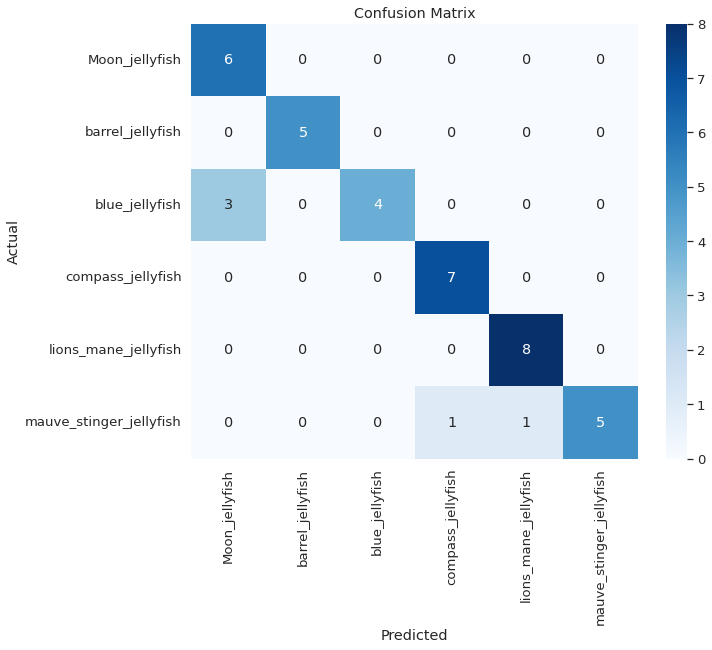

In [72]:
# 혼동 행렬 계산 및 시각화
y_pred_classes = np.concatenate([np.argmax(model.predict(x), axis=1) for x, _ in test_ds])
y_true_classes = np.concatenate([y for _, y in test_ds])

cm = confusion_matrix(y_true_classes, y_pred_classes)

plt.figure(figsize=(10, 8))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', xticklabels=class_names, yticklabels=class_names)
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.title('Confusion Matrix')
plt.show()

#### 테스트용 무작위 해파리 이미지 예측

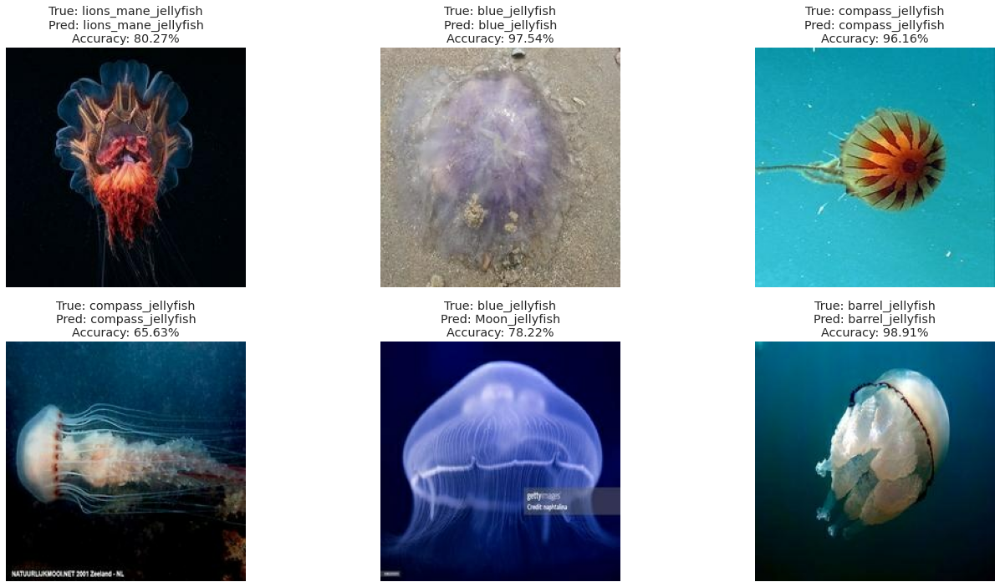

In [73]:
def predict_image(image_path):
    img = load_image(image_path)
    img = tf.expand_dims(img, axis=0)
    prediction = model.predict(img)
    predicted_idx = np.argmax(prediction[0])
    confidence = np.max(prediction[0])
    return class_names[predicted_idx], confidence

def predict_random_images(num_samples=5):
    # 무작위 샘플 선택
    random_indices = random.sample(range(len(X_test)), num_samples)
    selected_paths = [X_test[i] for i in random_indices]
    true_labels = [y_test[i] for i in random_indices]

    # 시각화 설정
    plt.figure(figsize=(20, 10))
    
    for i, (path, true_label) in enumerate(zip(selected_paths, true_labels)):
        # 예측 수행
        predicted_class, confidence = predict_image(path)
        
        # 원본 이미지 로드 (시각화용)
        img = tf.io.read_file(path)
        img = tf.image.decode_jpeg(img, channels=3)
        img = tf.image.resize(img, [224, 224])
        img = img.numpy().astype("uint8")

        # 결과 시각화
        plt.subplot(2, 3, i+1)
        plt.imshow(img)
        plt.title(f"True: {true_label}\nPred: {predicted_class}\nAccuracy: {confidence:.2%}")
        plt.axis('off')

    plt.tight_layout()
    plt.show()

# 6개 이미지 예측 실행
predict_random_images(6)

----
### 3.1.1 배경제거 데이터 성능 검증 - MobileNetV3

- Adam 옵티마이저와 고정된 learning rate(0.001)를 사용
- BatchNormalization과 Dropout을 포함해 학습 안정성과 과적합 방지
- GlobalAveragePooling2D를 사용해 파라미터 수를 줄이고 계산 효율성을 높임

#### 데이터 준비

In [74]:
# 데이터 경로 설정
base_path = Path("/aiffel/aiffel/jellyfish/Train_Test_Valid_2") # 배경제거 데이터

train_path = os.path.join(base_path, "Train")
valid_path = os.path.join(base_path, "valid")
test_path = os.path.join(base_path, "test")

def get_files_labels(directory):
    if not isinstance(directory, Path):
        directory = Path(directory)
    # 지원하는 이미지 확장자 목록
    image_extensions = ["*.jpg","*.JPG","*.PNG ","*.jpeg", "*.png"]
    
    # 모든 확장자를 포함한 파일 수집
    all_files = []
    for ext in image_extensions:
        all_files.extend(directory.rglob(ext))
    
    file_paths = [str(f) for f in all_files]
    labels = [f.parent.name for f in all_files]
    return file_paths, labels

# 데이터셋별 파일 경로 및 레이블 로드
X_train, y_train = get_files_labels(train_path)
X_val, y_val = get_files_labels(valid_path)
X_test, y_test = get_files_labels(test_path)

print(f"Train 데이터: {len(X_train)}개")
print(f"Validation 데이터: {len(X_val)}개")
print(f"Test 데이터: {len(X_test)}개")

Train 데이터: 900개
Validation 데이터: 39개
Test 데이터: 40개


#### 이미지 전처리

In [75]:
# 클래스 이름 정의 및 매핑 생성
class_names = sorted(set(y_train + y_val + y_test))
class_to_idx = {cls: i for i, cls in enumerate(class_names)}

# 이미지를 로드하고 전처리하는 함수 정의
def load_image(path):
    img = tf.io.read_file(path)
    img = tf.image.decode_jpeg(img, channels=3)
    img = tf.image.resize(img, [224, 224], method='bilinear')  # MobileNetV3 입력 크기
    return tf.keras.applications.mobilenet_v3.preprocess_input(img)

# TensorFlow Dataset 생성 함수 정의
def create_tf_dataset(paths, labels):
    labels = [class_to_idx[label] for label in labels]
    dataset = tf.data.Dataset.from_tensor_slices((paths, labels))
    dataset = dataset.map(lambda p, l: (load_image(p), l))  # 이미지 로드 및 전처리 적용
    return dataset

# Train/Validation/Test 데이터셋 생성
train_ds = create_tf_dataset(X_train, y_train).shuffle(1000).batch(32).prefetch(2)
valid_ds = create_tf_dataset(X_val, y_val).batch(32).prefetch(2)
test_ds = create_tf_dataset(X_test, y_test).batch(32)

#### 모델 구성

In [76]:
# MobileNetV3Large 로드
base_model = tf.keras.applications.MobileNetV3Large(
    input_shape=(224, 224, 3), include_top=False, weights='imagenet'
)
base_model.trainable = True
for layer in base_model.layers[:-5]:
    layer.trainable = False

# 사용자 정의 분류기 추가
model = models.Sequential([
    base_model,
    layers.GlobalAveragePooling2D(),
    layers.BatchNormalization(),
    layers.Dense(256, activation='relu'),  # 노드 수 증가  
    layers.Dropout(0.5),  # Dropout 비율 조정
    layers.Dense(len(class_names), activation='softmax')  # 클래스 출력층
])

# 모델 컴파일 및 학습
model.compile(
    optimizer=tf.keras.optimizers.Adam(learning_rate=0.0001),
    loss='sparse_categorical_crossentropy',
    metrics=['accuracy']
)

model.summary()

Model: "sequential_11"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
MobilenetV3large (Functional (None, 1, 1, 1280)        4226432   
_________________________________________________________________
global_average_pooling2d_24  (None, 1280)              0         
_________________________________________________________________
batch_normalization_18 (Batc (None, 1280)              5120      
_________________________________________________________________
dense_32 (Dense)             (None, 256)               327936    
_________________________________________________________________
dropout_22 (Dropout)         (None, 256)               0         
_________________________________________________________________
dense_33 (Dense)             (None, 6)                 1542      
Total params: 4,561,030
Trainable params: 1,562,118
Non-trainable params: 2,998,912
___________________________________

#### 모델 학습

In [77]:
callbacks = [
    tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=7, restore_best_weights=True),
    tf.keras.callbacks.ReduceLROnPlateau(monitor='val_loss', factor=0.2, patience=3, min_lr=1e-5)
]

history = model.fit(
    train_ds,
    validation_data=valid_ds,
    epochs=15,
    callbacks=callbacks
)

Epoch 1/15
29/29 [==============================] - 7s 74ms/step - loss: 1.8640 - accuracy: 0.4144 - val_loss: 1.2437 - val_accuracy: 0.4615
Epoch 2/15
29/29 [==============================] - 2s 41ms/step - loss: 0.6457 - accuracy: 0.7711 - val_loss: 1.0688 - val_accuracy: 0.4872
Epoch 3/15
29/29 [==============================] - 2s 40ms/step - loss: 0.4728 - accuracy: 0.8300 - val_loss: 1.0401 - val_accuracy: 0.4872
Epoch 4/15
29/29 [==============================] - 2s 41ms/step - loss: 0.2904 - accuracy: 0.9144 - val_loss: 1.0172 - val_accuracy: 0.4615
Epoch 5/15
29/29 [==============================] - 2s 40ms/step - loss: 0.2246 - accuracy: 0.9256 - val_loss: 1.0247 - val_accuracy: 0.5385
Epoch 6/15
29/29 [==============================] - 2s 40ms/step - loss: 0.2154 - accuracy: 0.9300 - val_loss: 1.0256 - val_accuracy: 0.5897
Epoch 7/15
29/29 [==============================] - 2s 40ms/step - loss: 0.1526 - accuracy: 0.9578 - val_loss: 1.0455 - val_accuracy: 0.5641
Epoch 8/15
29

#### 결과 시각화

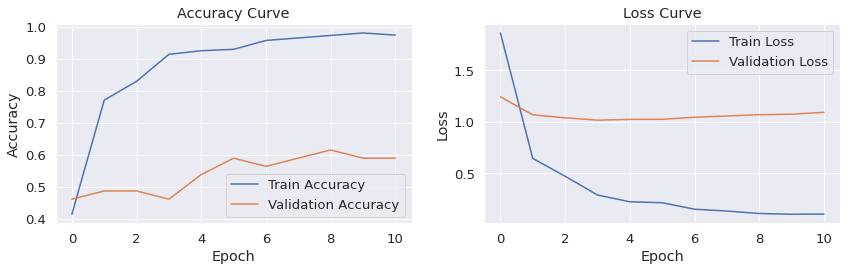

In [78]:
plt.figure(figsize=(12, 4))

# 정확도 곡선 시각화
plt.subplot(1, 2, 1)
plt.plot(history.history['accuracy'], label='Train Accuracy')
plt.plot(history.history['val_accuracy'], label='Validation Accuracy')
plt.title('Accuracy Curve')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.legend()

# 손실 곡선 시각화
plt.subplot(1, 2, 2)
plt.plot(history.history['loss'], label='Train Loss')
plt.plot(history.history['val_loss'], label='Validation Loss')
plt.title('Loss Curve')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()

plt.tight_layout()
plt.show()

#### 성능 평가

In [79]:
test_loss, test_acc = model.evaluate(test_ds)
print(f"테스트 손실: {test_loss:.4f}")
print(f"테스트 정확도: {test_acc:.4f}")

2/2 [==============================] - 0s 18ms/step - loss: 0.7254 - accuracy: 0.7250
테스트 손실: 0.7254
테스트 정확도: 0.7250


#### Confusion Matrix

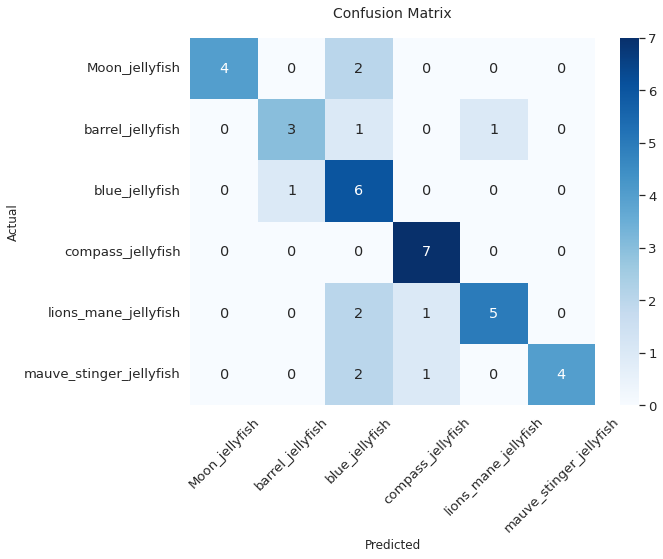

In [80]:
# 테스트 데이터 예측
y_pred = model.predict(test_ds)
y_pred_classes = np.argmax(y_pred, axis=1)

# 실제 레이블 추출
y_true = np.concatenate([y for x, y in test_ds], axis=0)

# 혼동 행렬 계산
cm = confusion_matrix(y_true, y_pred_classes)

# 시각화
plt.figure(figsize=(10, 8))
sns.set(font_scale=1.2)  # 글자 크기 조정 추가
ax = sns.heatmap(cm, annot=True, fmt='d', cmap='Blues',
                xticklabels=class_names,  
                yticklabels=class_names)  
ax.set_xticklabels(ax.get_xticklabels(), rotation=45)  # X축 라벨 회전 추가
ax.set_yticklabels(ax.get_yticklabels(), rotation=0)   # Y축 라벨 정렬
plt.xlabel('Predicted', fontsize=12)
plt.ylabel('Actual', fontsize=12)
plt.title('Confusion Matrix', pad=20, fontsize=14)
plt.tight_layout()  # 레이아웃 조정
plt.show()

#### 테스트용 무작위 해파리 이미지 예측

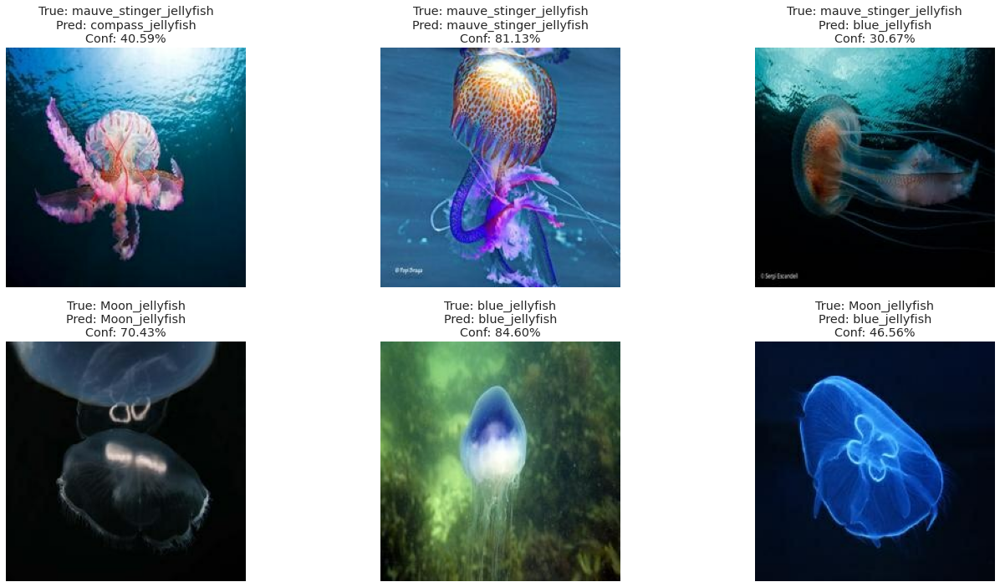

In [81]:
def predict_image(image_path):
    img = load_image(image_path)
    img = tf.expand_dims(img, axis=0)  # 배치 차원 추가
    prediction = model.predict(img)
    predicted_idx = np.argmax(prediction[0])
    confidence = np.max(prediction[0])
    return class_names[predicted_idx], confidence

def predict_random_images(num_samples=6):
    # 무작위 샘플 선택
    random_indices = random.sample(range(len(X_test)), num_samples)
    selected_paths = [X_test[i] for i in random_indices] # 테스트용 이미지 경로들의 리스트
    true_labels = [y_test[i] for i in random_indices] # 실제 레이블 리스트

    # 시각화 설정
    plt.figure(figsize=(20, 10))
    
    for i, (path, true_label) in enumerate(zip(selected_paths, true_labels)):
        # 예측 수행
        predicted_class, confidence = predict_image(path)
        
        # 원본 이미지 로드 
        img = tf.io.read_file(path)
        img = tf.image.decode_png(img, channels=3)
        img = tf.image.resize(img, [224, 224])
        img = img.numpy().astype("uint8")

        # 결과 시각화
        plt.subplot(2, 3, i+1) 
        plt.imshow(img)
        plt.title(f"True: {true_label}\nPred: {predicted_class}\nConf: {confidence:.2%}")
        plt.axis('off')

    plt.tight_layout()
    plt.show()

# 6개 이미지 예측 실행
predict_random_images(6)

### 3.1.2 한 이미지 내에 여러 개체가 있는 경우를 제거한 데이터 성능검증 - MobilenetV3

#### 데이터 준비

In [91]:
# 한 이미지 내에 여러 개체가 있는 경우를 제거한 데이터 경로 설정
base_path = Path("/aiffel/aiffel/jellyfish/Train_Test_Valid_Single")

train_path = os.path.join(base_path, "Train")
valid_path = os.path.join(base_path, "valid")
test_path = os.path.join(base_path, "test")

def get_files_labels(directory):
    if not isinstance(directory, Path):
        directory = Path(directory)
    # 지원하는 이미지 확장자 목록
    image_extensions = ["*.jpg","*.JPG","*.PNG ","*.jpeg", "*.png"]
    
    # 모든 확장자를 포함한 파일 수집
    all_files = []
    for ext in image_extensions:
        all_files.extend(directory.rglob(ext))
    
    file_paths = [str(f) for f in all_files]
    labels = [f.parent.name for f in all_files]
    return file_paths, labels

# 데이터셋별 파일 경로 및 레이블 로드
X_train, y_train = get_files_labels(train_path)
X_val, y_val = get_files_labels(valid_path)
X_test, y_test = get_files_labels(test_path)

print(f"Train 데이터: {len(X_train)}개")
print(f"Validation 데이터: {len(X_val)}개")
print(f"Test 데이터: {len(X_test)}개")

Train 데이터: 818개
Validation 데이터: 39개
Test 데이터: 40개


#### 이미지 전처리

In [92]:
# 클래스 이름 정의 및 매핑 생성
class_names = sorted(set(y_train + y_val + y_test))
class_to_idx = {cls: i for i, cls in enumerate(class_names)}

# 이미지를 로드하고 전처리하는 함수 정의
def load_image(path):
    img = tf.io.read_file(path)
    img = tf.image.decode_jpeg(img, channels=3)
    img = tf.image.resize(img, [224, 224])  # MobileNetV3 입력 크기
    return tf.keras.applications.mobilenet_v3.preprocess_input(img)

# TensorFlow Dataset 생성 함수 정의
def create_tf_dataset(paths, labels):
    labels = [class_to_idx[label] for label in labels]
    dataset = tf.data.Dataset.from_tensor_slices((paths, labels))
    dataset = dataset.map(lambda p, l: (load_image(p), l))  # 이미지 로드 및 전처리 적용
    return dataset

# Train/Validation/Test 데이터셋 생성
train_ds = create_tf_dataset(X_train, y_train).shuffle(1000).batch(32).prefetch(2)
valid_ds = create_tf_dataset(X_val, y_val).batch(32).prefetch(2)
test_ds = create_tf_dataset(X_test, y_test).batch(32)

#### 모델 구성

In [ ]:
# MobileNetV3Large 로드
base_model = tf.keras.applications.MobileNetV3Large(
    input_shape=(224, 224, 3), include_top=False, weights='imagenet'
)
base_model.trainable = True
for layer in base_model.layers[:-5]:
    layer.trainable = False

# 사용자 정의 분류기 추가
model = models.Sequential([
    base_model,
    layers.GlobalAveragePooling2D(),
    layers.BatchNormalization(),
    layers.Dense(256, activation='relu'),  # 노드 수 증가  
    layers.Dropout(0.5),  # Dropout 비율 조정
    layers.Dense(len(class_names), activation='softmax')  # 클래스 출력층
])

# 모델 컴파일 및 학습
model.compile(
    optimizer=tf.keras.optimizers.Adam(learning_rate=0.0001),
    loss='sparse_categorical_crossentropy',
    metrics=['accuracy']
)

model.summary()

#### 모델 학습

In [87]:
callbacks = [
    tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=7, restore_best_weights=True),
    tf.keras.callbacks.ReduceLROnPlateau(monitor='val_loss', factor=0.2, patience=3, min_lr=1e-5)
]

history = model.fit(
    train_ds,
    validation_data=valid_ds,
    epochs=15,
    callbacks=callbacks
)


Epoch 1/15
26/26 [==============================] - 6s 82ms/step - loss: 1.6239 - accuracy: 0.4328 - val_loss: 1.2211 - val_accuracy: 0.5128
Epoch 2/15
26/26 [==============================] - 1s 41ms/step - loss: 0.5993 - accuracy: 0.7983 - val_loss: 1.0471 - val_accuracy: 0.5128
Epoch 3/15
26/26 [==============================] - 1s 40ms/step - loss: 0.3808 - accuracy: 0.8655 - val_loss: 0.9724 - val_accuracy: 0.5897
Epoch 4/15
26/26 [==============================] - 1s 41ms/step - loss: 0.2025 - accuracy: 0.9389 - val_loss: 0.9399 - val_accuracy: 0.6154
Epoch 5/15
26/26 [==============================] - 1s 40ms/step - loss: 0.1506 - accuracy: 0.9597 - val_loss: 0.9265 - val_accuracy: 0.6410
Epoch 6/15
26/26 [==============================] - 1s 40ms/step - loss: 0.1316 - accuracy: 0.9633 - val_loss: 0.9258 - val_accuracy: 0.6667
Epoch 7/15
26/26 [==============================] - 1s 41ms/step - loss: 0.1082 - accuracy: 0.9694 - val_loss: 0.9193 - val_accuracy: 0.6667
Epoch 8/15
26

#### 결과 시각화

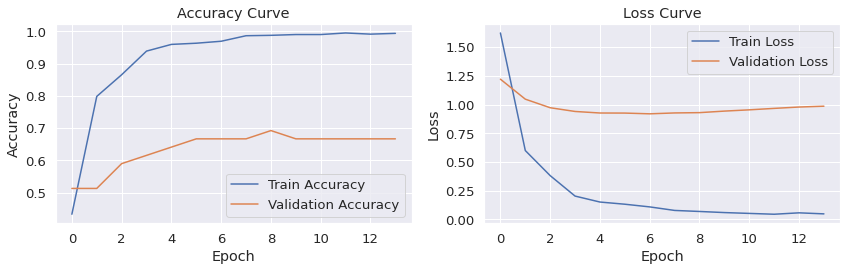

In [88]:
plt.figure(figsize=(12, 4))

# 정확도 곡선 시각화
plt.subplot(1, 2, 1)
plt.plot(history.history['accuracy'], label='Train Accuracy')
plt.plot(history.history['val_accuracy'], label='Validation Accuracy')
plt.title('Accuracy Curve')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.legend()

# 손실 곡선 시각화
plt.subplot(1, 2, 2)
plt.plot(history.history['loss'], label='Train Loss')
plt.plot(history.history['val_loss'], label='Validation Loss')
plt.title('Loss Curve')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()

plt.tight_layout()
plt.show()

#### 성능 평가

In [89]:
test_loss, test_acc = model.evaluate(test_ds)
print(f"테스트 손실: {test_loss:.4f}")
print(f"테스트 정확도: {test_acc:.4f}")

2/2 [==============================] - 0s 16ms/step - loss: 0.4337 - accuracy: 0.8750
테스트 손실: 0.4337
테스트 정확도: 0.8750


#### Confusion Matrix

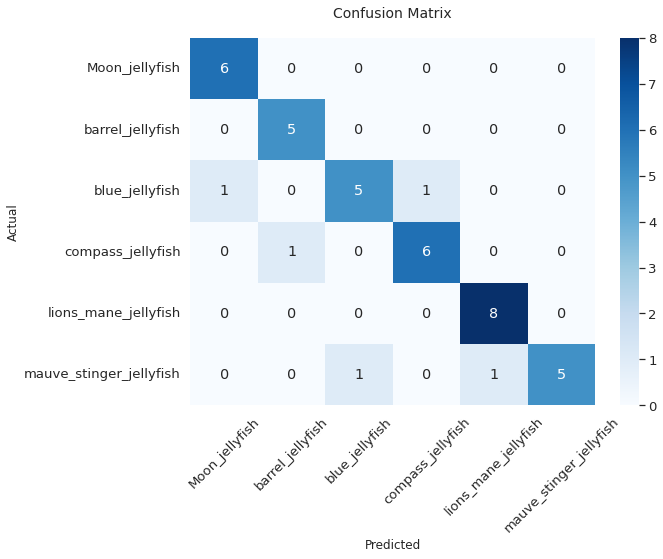

In [90]:
# 테스트 데이터 예측
y_pred = model.predict(test_ds)
y_pred_classes = np.argmax(y_pred, axis=1)

# 실제 레이블 추출
y_true = np.concatenate([y for x, y in test_ds], axis=0)

# 혼동 행렬 계산
cm = confusion_matrix(y_true, y_pred_classes)

# 시각화
plt.figure(figsize=(10, 8))
sns.set(font_scale=1.2)  # 글자 크기 조정 추가
ax = sns.heatmap(cm, annot=True, fmt='d', cmap='Blues',
                xticklabels=class_names,  
                yticklabels=class_names)  
ax.set_xticklabels(ax.get_xticklabels(), rotation=45)  # X축 라벨 회전 추가
ax.set_yticklabels(ax.get_yticklabels(), rotation=0)   # Y축 라벨 정렬
plt.xlabel('Predicted', fontsize=12)
plt.ylabel('Actual', fontsize=12)
plt.title('Confusion Matrix', pad=20, fontsize=14)
plt.tight_layout()  # 레이아웃 조정
plt.show()

### 배경 제거 데이터 모델 해석 기법 적용 Grad-Cam 

#### 이미지 전처리 함수

In [25]:
def preprocess_image(img_path, target_size=(224, 224)):
    img = tf.keras.preprocessing.image.load_img(img_path, target_size=target_size)
    img_array = tf.keras.preprocessing.image.img_to_array(img)
    img_array = np.expand_dims(img_array, axis=0) # 배치 차원 추가 (shape: [1,])
    return tf.keras.applications.mobilenet_v3.preprocess_input(img_array)

#### Grad-CAM 히트맵 생성 함수

In [26]:
def make_gradcam_heatmap(img_array, model, last_conv_layer_name, pred_index=None):
    # 마지막 컨볼루션 레이어와 출력값을 동시에 가져오는 모델 정의
    grad_model = tf.keras.models.Model(
        [model.inputs],
        [model.get_layer(last_conv_layer_name).output, model.output]
    )
    
    with tf.GradientTape() as tape:
        conv_outputs, predictions = grad_model(img_array)
        if pred_index is None:
            pred_index = tf.argmax(predictions[0])
        loss = predictions[:, pred_index]
    
    # 그라디언트 계산
    grads = tape.gradient(loss, conv_outputs)
    pooled_grads = tf.reduce_mean(grads, axis=(0, 1, 2))
    
    # 히트맵 계산
    conv_outputs = conv_outputs[0]
    heatmap = tf.reduce_sum(tf.multiply(pooled_grads, conv_outputs), axis=-1)
    heatmap = np.maximum(heatmap.numpy(), 0)
    heatmap /= np.max(heatmap) # 범위로 스케일링
    
    return heatmap

#### 히트맵 오버레이 함수

In [27]:
def overlay_heatmap(heatmap, img_path, alpha=0.4):
    img = cv2.imread(img_path)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB) # 원본 이미지를 RGB 형식으로 로드
    
    heatmap = cv2.resize(heatmap, (img.shape[1], img.shape[0]))
    heatmap = np.uint8(255 * heatmap)
    
    jet = cv2.applyColorMap(heatmap, cv2.COLORMAP_JET) # 빨강-파랑 컬러맵 적용
    superimposed_img = cv2.addWeighted(jet, alpha, img, 1 - alpha, 0) # addWeighted: 히트맵(jet)과 원본 이미지를 투명도(alpha)로 혼합
    
    return superimposed_img

#### 메인 실행

22675456/22661472 [==============================] - 0s 0us/step


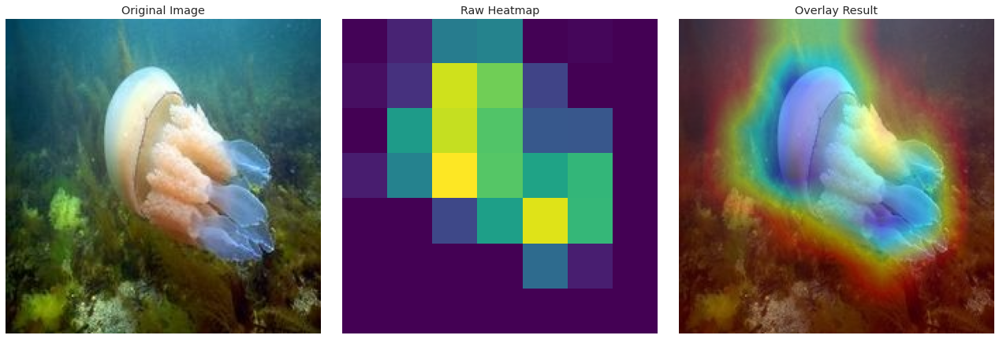

In [28]:
if __name__ == "__main__":
    # MobileNetV3 모델 로드
    model = tf.keras.applications.MobileNetV3Large(
        input_shape=(224, 224, 3),
        weights="imagenet",
        include_top=True
    )
    
    # Grad-CAM을 적용할 레이어 지정
    last_conv_layer_name = "Conv_1"
    
    # 이미지 경로 설정
    img_path = "/aiffel/aiffel/jellyfish/barrel_jellyfish/01.jpeg"
    
    # 1. 원본 이미지 로드 및 전처리
    img_array = preprocess_image(img_path)  # 모델 입력용 전처리된 이미지
    
    # 2. 히트맵 생성
    heatmap = make_gradcam_heatmap(img_array, model, last_conv_layer_name)
    
    # 3. 시각화를 위한 원본 이미지 별도 로드 (전처리 없음)
    original_img = tf.io.read_file(img_path)
    original_img = tf.image.decode_png(original_img, channels=3)
    original_img = tf.image.resize(original_img, [224, 224])  # 리사이즈만 수행
    original_img = original_img.numpy().astype("uint8")  # [0-255] 범위 유지
    
    # 4. 히트맵 오버레이 생성
    superimposed_img = overlay_heatmap(heatmap, img_path)

    # 5. 3개의 서브플롯으로 시각화
    plt.figure(figsize=(18, 6))
    
    # 원본 이미지
    plt.subplot(1, 3, 1)
    plt.imshow(original_img)
    plt.title("Original Image")
    plt.axis('off')
    
    # 순수 히트맵
    plt.subplot(1, 3, 2)
    plt.imshow(heatmap, cmap='viridis')  # 컬러맵으로 히트맵 시각화
    plt.title("Raw Heatmap")
    plt.axis('off')
    
    # 합성 이미지
    plt.subplot(1, 3, 3)
    plt.imshow(superimposed_img)
    plt.title("Overlay Result")
    plt.axis('off')

    plt.tight_layout()
    plt.show()

1. 원본 이미지
    - 해파리와 주변 배경이 선명하게 표현
    - 해파리의 텍스처와 디테일이 명확하며, 배경은 자연스러운 바다 환경
2. 히트맵
    - 모델이 집중한 영역이 해파리의 몸통과 촉수 부분에 잘 나타나 있습니다.
    - 히트맵은 비교적 균형 있게 분포, 모델이 해파리를 잘 인식
3. 오버레이 결과
    - 원본 이미지 위에 히트맵이 자연스럽게 오버레이

#### 원본이미지 배경제거 전처리 후 히트맵 시각화

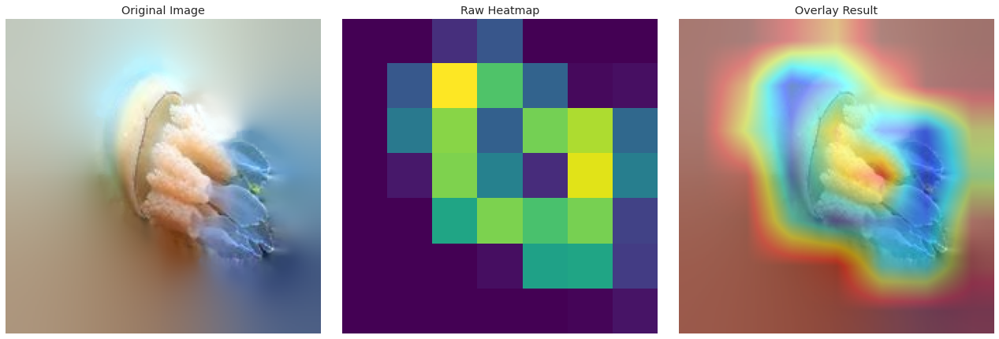

In [87]:
if __name__ == "__main__":
    # MobileNetV3 모델 로드
    model = tf.keras.applications.MobileNetV3Large(
        input_shape=(224, 224, 3),
        weights="imagenet",
        include_top=True
    )
    
    # Grad-CAM을 적용할 레이어 지정
    last_conv_layer_name = "Conv_1"
    
    # 이미지 경로 설정
    img_path = "/aiffel/aiffel/jellyfish/jellyfish_background_remove/barrel_jellyfish_output_again/01.jpg"
    
    # 1. 원본 이미지 로드 및 전처리
    img_array = preprocess_image(img_path)  # 모델 입력용 전처리된 이미지
    
    # 2. 히트맵 생성
    heatmap = make_gradcam_heatmap(img_array, model, last_conv_layer_name)
    
    # 3. 시각화를 위한 원본 이미지 별도 로드 
    original_img = tf.io.read_file(img_path)
    original_img = tf.image.decode_png(original_img, channels=3)
    original_img = tf.image.resize(original_img, [224, 224])  # 리사이즈만 수행
    original_img = original_img.numpy().astype("uint8")  # [0-255] 범위 유지
    
    # 4. 히트맵 오버레이 생성
    superimposed_img = overlay_heatmap(heatmap, img_path)

    # 5. 3개의 서브플롯으로 시각화
    plt.figure(figsize=(18, 6))
    
    # 원본 이미지
    plt.subplot(1, 3, 1)
    plt.imshow(original_img)
    plt.title("Original Image")
    plt.axis('off')
    
    # 순수 히트맵
    plt.subplot(1, 3, 2)
    plt.imshow(heatmap, cmap='viridis')  # 컬러맵으로 히트맵 시각화
    plt.title("Raw Heatmap")
    plt.axis('off')
    
    # 합성 이미지
    plt.subplot(1, 3, 3)
    plt.imshow(superimposed_img)
    plt.title("Overlay Result")
    plt.axis('off')

    plt.tight_layout()
    plt.show()

1. 원본이미지
    - 배경이 제거된 상태로, 해파리 주변이 흐릿하게 처리
    - 배경 제거 과정에서 경계처리, 전체적으로 뿌연 효과
2. 히트맵
    - 히트맵은 해파리의 몸통과 촉수 부분에 집중
    - 히트맵 자체는 모델의 활성화 영역을 잘 보여주지만 원본 이미지의 품질 저하로 인해 시각적 효과가 감소
3. 오버레이 결과
    - 흐릿한 배경 위에 히트맵이 오버레이되면서 결과적으로 뿌연 느낌
    - 원본 이미지가 흐릿하기 때문에 히트맵의 강조 효과가 덜 선명

#### 결론

1. 배경 제거 알고리즘은 완벽하지 않으며, 경계 처리를 위해 블러링을 적용
2. 결과 이미지가 투명 배경 대신 흰색이나 다른 색상으로 채워질 수 있음.

#### 개선점

배경 제거 이미지를 개선하려면 배경 제거 과정에서 경계 처리를 강화하거나, 배경 제거 후 경계 강화 및 선명화 작업을 추가하는 것이 필요

 ### 4.1.2 Mobilnet V2 성능검증
- Adam 옵티마이저와 고정된 learning rate(0.001)를 사용
- BatchNormalization과 Dropout을 포함해 학습 안정성과 과적합 방지
- GlobalAveragePooling2D를 사용해 파라미터 수를 줄이고 계산 효율성을 높임

- 테스트 손실: 0.4183
- 테스트 정확도: 0.8750

#### 데이터 준비

In [20]:
# 이미지 파일 경로와 레이블 수집 함수
def get_files_labels(directory):
    # 지원하는 이미지 확장자 목록
    if not isinstance(directory, Path):
        directory = Path(directory)
    image_extensions = ["*.jpg","*.JPG","*.PNG ","*.jpeg", "*.png"]
    
    # 모든 확장자를 포함한 파일 수집
    all_files = []
    for ext in image_extensions:
        all_files.extend(directory.rglob(ext))
    
    file_paths = [str(f) for f in all_files]
    labels = [f.parent.name for f in all_files]
    return file_paths, labels

# 데이터셋별 파일 경로 및 레이블 로드
X_train, y_train = get_files_labels(train_path)
X_val, y_val = get_files_labels(valid_path)
X_test, y_test = get_files_labels(test_path)

print(f"Train 데이터: {len(X_train)}개")
print(f"Validation 데이터: {len(X_val)}개")
print(f"Test 데이터: {len(X_test)}개")

Train 데이터: 900개
Validation 데이터: 39개
Test 데이터: 40개


#### 이미지 전처리

In [21]:
# 클래스 이름 정의 및 매핑 생성
class_names = sorted(set(y_train + y_val + y_test))
class_to_idx = {cls: i for i, cls in enumerate(class_names)}

# 이미지를 로드하고 전처리하는 함수 정의
def load_image(path):
    img = tf.io.read_file(path)
    img = tf.image.decode_jpeg(img, channels=3)
    img = tf.image.resize(img, [224, 224])  # MobileNetV2 입력 크기
    return tf.keras.applications.mobilenet_v2.preprocess_input(img)

# TensorFlow Dataset 생성 함수 정의
def create_tf_dataset(paths, labels):
    labels = [class_to_idx[label] for label in labels]
    dataset = tf.data.Dataset.from_tensor_slices((paths, labels))
    dataset = dataset.map(lambda p, l: (load_image(p), l))  # 이미지 로드 및 전처리 적용
    return dataset

# Train/Validation/Test 데이터셋 생성
train_ds = create_tf_dataset(X_train, y_train).shuffle(1000).batch(32).prefetch(2)
valid_ds = create_tf_dataset(X_val, y_val).batch(32).prefetch(2)
test_ds = create_tf_dataset(X_test, y_test).batch(32)

#### 모델 구성

In [22]:
# MobileNetV2 모델 로드 및 고정
base_model = tf.keras.applications.MobileNetV2(
    input_shape=(224, 224, 3), include_top=False, weights='imagenet'
)
base_model.trainable = False  # 사전 학습된 가중치 고정

# 사용자 정의 분류기 추가
model = models.Sequential([
    base_model,
    layers.GlobalAveragePooling2D(),
    layers.BatchNormalization(),
    layers.Dense(128, activation='relu'),
    layers.BatchNormalization(),
    layers.Dropout(0.5),
    layers.Dense(len(class_names), activation='softmax')  # 클래스 수에 맞게 출력층 설정
])

# 모델 컴파일
model.compile(
    optimizer=tf.keras.optimizers.Adam(learning_rate=0.001),
    loss='sparse_categorical_crossentropy',
    metrics=['accuracy']
)

model.summary()

Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
mobilenetv2_1.00_224 (Functi (None, 7, 7, 1280)        2257984   
_________________________________________________________________
global_average_pooling2d_1 ( (None, 1280)              0         
_________________________________________________________________
batch_normalization_2 (Batch (None, 1280)              5120      
_________________________________________________________________
dense_2 (Dense)              (None, 128)               163968    
_________________________________________________________________
batch_normalization_3 (Batch (None, 128)               512       
_________________________________________________________________
dropout_1 (Dropout)          (None, 128)               0         
_________________________________________________________________
dense_3 (Dense)              (None, 6)                

#### 모델 학습

In [23]:
callbacks = [
    tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=5, restore_best_weights=True),
    tf.keras.callbacks.ReduceLROnPlateau(monitor='val_loss', factor=0.2, patience=2, min_lr=1e-5)
]

history = model.fit(
    train_ds,
    validation_data=valid_ds,
    epochs=30,
    callbacks=callbacks
)

Epoch 1/30
29/29 [==============================] - 6s 90ms/step - loss: 1.2592 - accuracy: 0.5956 - val_loss: 1.0721 - val_accuracy: 0.6410
Epoch 2/30
29/29 [==============================] - 2s 41ms/step - loss: 0.3411 - accuracy: 0.8800 - val_loss: 0.9136 - val_accuracy: 0.7179
Epoch 3/30
29/29 [==============================] - 2s 42ms/step - loss: 0.2051 - accuracy: 0.9378 - val_loss: 0.8108 - val_accuracy: 0.7179
Epoch 4/30
29/29 [==============================] - 2s 41ms/step - loss: 0.1525 - accuracy: 0.9522 - val_loss: 0.7430 - val_accuracy: 0.7179
Epoch 5/30
29/29 [==============================] - 2s 42ms/step - loss: 0.1413 - accuracy: 0.9622 - val_loss: 0.7265 - val_accuracy: 0.7692
Epoch 6/30
29/29 [==============================] - 2s 42ms/step - loss: 0.1087 - accuracy: 0.9689 - val_loss: 0.7925 - val_accuracy: 0.7436
Epoch 7/30
29/29 [==============================] - 2s 42ms/step - loss: 0.0955 - accuracy: 0.9778 - val_loss: 0.7409 - val_accuracy: 0.8205
Epoch 8/30
29

#### 결과 시각화

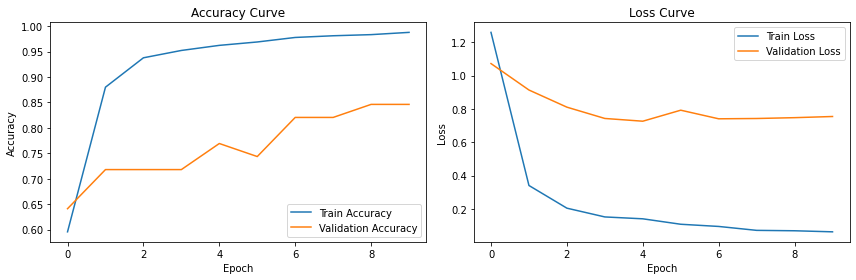

In [24]:
plt.figure(figsize=(12, 4))

# 정확도 곡선 시각화
plt.subplot(1, 2, 1)
plt.plot(history.history['accuracy'], label='Train Accuracy')
plt.plot(history.history['val_accuracy'], label='Validation Accuracy')
plt.title('Accuracy Curve')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.legend()

# 손실 곡선 시각화
plt.subplot(1, 2, 2)
plt.plot(history.history['loss'], label='Train Loss')
plt.plot(history.history['val_loss'], label='Validation Loss')
plt.title('Loss Curve')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()

plt.tight_layout()
plt.show()

#### 성능 평가

In [25]:
# 테스트 데이터 평가
test_loss, test_acc = model.evaluate(test_ds)
print(f"테스트 손실: {test_loss:.4f}")
print(f"테스트 정확도: {test_acc:.4f}")

2/2 [==============================] - 0s 272ms/step - loss: 0.4183 - accuracy: 0.8750
테스트 손실: 0.4183
테스트 정확도: 0.8750


#### Confusion_Matrix

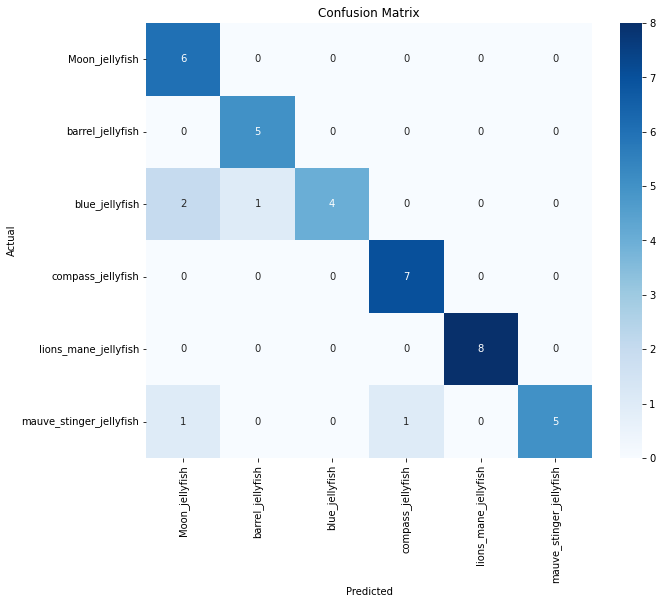

In [26]:
# 혼동 행렬 계산 및 시각화
y_pred_classes = np.concatenate([np.argmax(model.predict(x), axis=1) for x, _ in test_ds])
y_true_classes = np.concatenate([y for _, y in test_ds])

cm = confusion_matrix(y_true_classes, y_pred_classes)

plt.figure(figsize=(10, 8))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', xticklabels=class_names, yticklabels=class_names)
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.title('Confusion Matrix')
plt.show()

#### 테스트용 무작위 해파리 이미지 예측

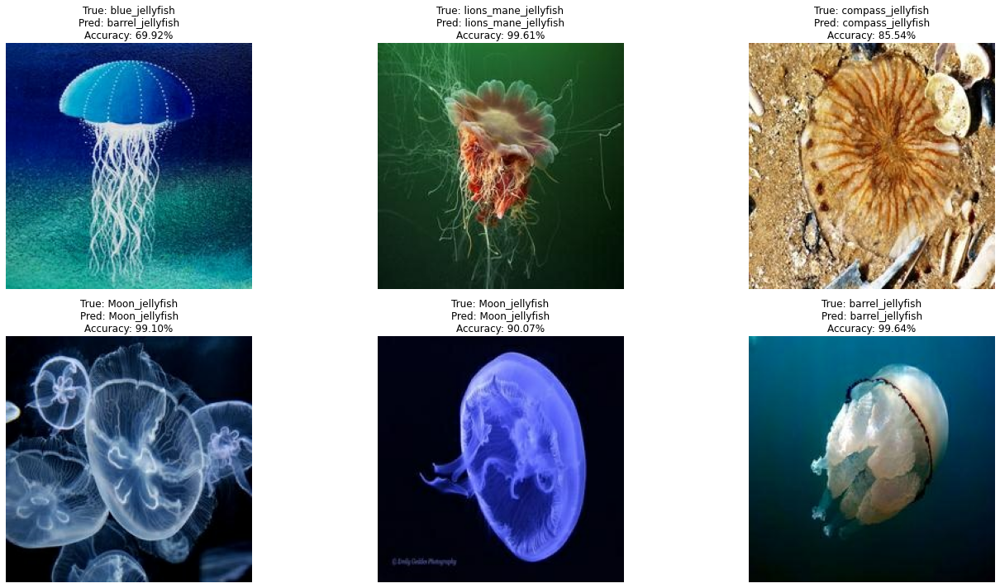

In [27]:
def predict_image(image_path):
    img = load_image(image_path)
    img = tf.expand_dims(img, axis=0)  # 배치 차원 추가
    prediction = model.predict(img)
    predicted_idx = np.argmax(prediction[0])
    confidence = np.max(prediction[0])
    return class_names[predicted_idx], confidence

def predict_random_images(num_samples=5):
    # 무작위 샘플 선택
    random_indices = random.sample(range(len(X_test)), num_samples)
    selected_paths = [X_test[i] for i in random_indices]
    true_labels = [y_test[i] for i in random_indices]

    # 시각화 설정
    plt.figure(figsize=(20, 10))
    
    for i, (path, true_label) in enumerate(zip(selected_paths, true_labels)):
        # 예측 수행
        predicted_class, confidence = predict_image(path)
        
        # 원본 이미지 로드 (시각화용)
        img = tf.io.read_file(path)
        img = tf.image.decode_jpeg(img, channels=3)
        img = tf.image.resize(img, [224, 224])
        img = img.numpy().astype("uint8")

        # 결과 시각화
        plt.subplot(2, 3, i+1)  # 2행 3열 그리드
        plt.imshow(img)
        plt.title(f"True: {true_label}\nPred: {predicted_class}\nAccuracy: {confidence:.2%}")
        plt.axis('off')

    plt.tight_layout()
    plt.show()

# 6개 이미지 예측 실행
predict_random_images(6)

-----
# 나중에 쓸거
- 채널 통계
- 텍스쳐 시각화

9. 채널 통계

- 나중에 성능 개선하면서 정규화에 쓰는 것이 낫겠네요...

In [73]:
r_values = []
g_values = []
b_values = []

# 전체 이미지 순회
for class_name in os.listdir(train_path):
    class_dir = os.path.join(train_path, class_name)
    if not os.path.isdir(class_dir):
        continue

    for img_name in tqdm(os.listdir(class_dir), desc=f"Processing {class_name}"):
        img_path = os.path.join(class_dir, img_name)
        img = cv2.imread(img_path)

        if img is None:
            continue

        img = cv2.resize(img, (224, 224))
        img = img / 255.0  # 정규화

        b, g, r = cv2.split(img)

        b_values.append(b.flatten())
        g_values.append(g.flatten())
        r_values.append(r.flatten())

# 배열로 합치기
r_all = np.concatenate(r_values)
g_all = np.concatenate(g_values)
b_all = np.concatenate(b_values)

# 평균과 표준편차 계산
r_mean, r_std = np.mean(r_all), np.std(r_all)
g_mean, g_std = np.mean(g_all), np.std(g_all)
b_mean, b_std = np.mean(b_all), np.std(b_all)

print("📊 채널 평균 + 표준편차:")
print(f"Red   - mean: {r_mean:.4f}, std: {r_std:.4f}")
print(f"Green - mean: {g_mean:.4f}, std: {g_std:.4f}")
print(f"Blue  - mean: {b_mean:.4f}, std: {b_std:.4f}")

Processing Moon_jellyfish: 100%|██████████████████████████████████████████████████████████| 150/150 [00:00<00:00, 339.68it/s]


📊 채널 평균 + 표준편차:
Red   - mean: 0.2613, std: 0.2735
Green - mean: 0.3637, std: 0.2626
Blue  - mean: 0.4198, std: 0.2810


In [ ]:
import cv2
import numpy as np
from skimage.feature import local_binary_pattern


def visualize_texture_from_class(class_name):
    class_path = os.path.join('/root/aiffel/jellyfish/Train_Test_Valid/Train', class_name)
    image_files = os.listdir(class_path)
    img_path = os.path.join(class_path, random.choice(image_files))

    # 원본 이미지 로드
    img = cv2.imread(img_path)
    img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

    # 1. 윤곽선 (Canny)
    edges = cv2.Canny(gray, 100, 200)

    # 2. Gabor 필터 (방향성 질감)
    g_kernel = cv2.getGaborKernel((31, 31), 4.0, np.pi/4, 10.0, 0.5, 0)
    gabor = cv2.filter2D(gray, cv2.CV_8UC3, g_kernel)

    # 3. LBP (Local Binary Pattern)
    lbp = local_binary_pattern(gray, P=24, R=3, method='uniform')

    # 시각화
    plt.figure(figsize=(16, 4))
    plt.suptitle(f"🧪 텍스처 분석: {class_name}", fontsize=16)

    plt.subplot(1, 5, 1)
    plt.imshow(img_rgb)
    plt.title('Original')
    plt.axis('off')

    plt.subplot(1, 5, 2)
    plt.imshow(gray, cmap='gray')
    plt.title('Gray')
    plt.axis('off')

    plt.subplot(1, 5, 3)
    plt.imshow(edges, cmap='gray')
    plt.title('Canny Edges')
    plt.axis('off')

    plt.subplot(1, 5, 4)
    plt.imshow(gabor, cmap='gray')
    plt.title('Gabor Filter')
    plt.axis('off')

    plt.subplot(1, 5, 5)
    plt.imshow(lbp, cmap='gray')
    plt.title('Local Binary Pattern')
    plt.axis('off')

    plt.tight_layout()
    plt.show()

# 원하는 클래스 이름만 넣어줘! 예: 'moon_jellyfish'
visualize_texture_from_class('Moon_jellyfish')

클래스 랜덤으로 선택

In [ ]:
def get_random_classname():
    train_path = '/root/aiffel/jellyfish/Train_Test_Valid/Train'
    return random.choice(os.listdir(train_path))

random_class = get_random_classname()
print(f"랜덤 클래스: {random_class}")
visualize_texture_from_class(random_class)